# Машинное обучение, ФКН ВШЭ

# Практическое задание 10. Обучение без учителя.

## Общая информация
Дата выдачи: 26.03.2025

Мягкий дедлайн: 13.04.2025 23:59 MSK

Жёсткий дедлайн: 17.04.2025 23:59 MSK

## Оценивание и штрафы

Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи).

Сдавать задание после указанного срока сдачи нельзя.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

Неэффективная реализация кода может негативно отразиться на оценке.

## Формат сдачи
Задания сдаются через систему anytask. Посылка должна содержать:
* Ноутбук homework-practice-10-Username.ipynb

Username — ваша фамилия на латинице

## О задании

В этом задании мы посмотрим на несколько алгоритмов кластеризации и применим их к географическим и текстовым данным. Также мы подробно остановимся на тематическом моделировании текстов, задаче обучения представлений и в каком-то смысле поработаем с semi-supervised learning.



In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

np.random.seed(0xFFFFFFF)

**Задание 0 (1e-100 балла)**. Опишите свои ощущения от домашки по ЕМ-алгоритму (можно картинкой или мемом).

Такого унижения я давно не испытывал.

In [ ]:
# YOUR CODE HERE (ノಠ益ಠ)ノ彡┻━┻

## Часть 1. Кластеризация автобусных остановок

В этом задании мы сравним разные алгоритмы кластеризации для данных об автобусных остановках Москвы.

**Задание 1.1 (1 балл).** Реализуйте алгоритм спектральной кластеризации, который упоминался на лекции. Для этого разберитесь с кодом шаблона, данного ниже, и допишите недостающую функцию. Напомним, что для графа с матрицей смежности $W = \{w_{ij}\}_{i, j = 1 \dots \ell}$ лапласиан определяется как:

$$
L = D - W,
$$

где $D = \text{diag}(d_1, ..., d_{\ell}), d_i = \sum_{j=1}^{\ell} w_{ij}$.

In [ ]:
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans
from scipy.linalg import eigh


class GraphClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Spectral clustering algorithm
        param n_clusters: number of clusters to form
        param n_components: number of eigenvectors to use
        '''

        if n_components is None:
            n_components = n_clusters

        self.n_components = n_components
        self.kmeans = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Perform spectral clustering from graph adjacency matrix
        and return vertex labels.
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, ) - vertex labels
        '''

        eigenvectors = self._generate_eigenvectors(X)
        labels = self.kmeans.fit_predict(eigenvectors[:, 1:])
        return labels

    def _generate_eigenvectors(self, X):
        '''
        Compute eigenvectors for spectral clustering
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_components) - eigenvectors
        '''
        d = np.sum(X, axis = 1)
        D = d * np.eye(len(d))

        L = D - X

        eigenvalues, eigenvectors = eigh(L)

        wanted_eigenvectors = eigenvectors[:, :self.n_components]

        return wanted_eigenvectors

Перед тем, как переходить к следующему заданию, протестируйте свое решение.

In [ ]:
n_blocks, n_vertices = 10, 1000
block_vertices = n_vertices // n_blocks

X = np.zeros((n_vertices, n_vertices))
for i in range(0, n_vertices, block_vertices):
    X[i:i + block_vertices, i:i + block_vertices] = np.sqrt(i + 1)

graph_clustering = GraphClustering(n_clusters=n_blocks)
labels = graph_clustering.fit_predict(X)

true_labels = np.zeros(n_vertices, dtype=np.int32)
for i in range(0, n_vertices, block_vertices):
    true_labels[i:i + block_vertices] = labels[i]

assert labels.shape == (n_vertices, )
assert np.all(np.bincount(labels) == np.full(n_blocks, block_vertices))
assert np.all(labels == true_labels)

Теперь можем приступить к работе с реальными данными. Скачайте файл с данными об остановках общественного транспорта **в формате .xlsx** по [ссылке](https://data.mos.ru/opendata/download/60464/1/201) (так гарантированно не возникнет проблем с парсингом файла) и загрузите таблицу в ноутбук. Альтернативная ссылка: [отсюда](https://disk.yandex.ru/i/J0HlcDXd_KyIeg). Для удобства визуализации мы будем работать только с остановками в ЦАО.

In [ ]:
data = pd.read_excel('transport.xlsx')
data = data[data.AdmArea_en == "Czentral`ny'j administrativny'j okrug"]
data = data.reset_index()
data.head()

,index,ID_en,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData
0,278,347,"«2-й Лесной пер.», улица Бутырский Вал (347)",37.586584,55.782106,улица Бутырский Вал,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ18; А12; АТ56; АТ78,2-й Лесной пер.,NaN,да,ГУП «Мосгортранс»,active,889085436,NaN
1,279,349,"«Ул. Сущевский Вал», Новослободская улица (349)",37.590714,55.790630,Новослободская улица,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ47; АМ10; АТ3; АТ56; АТ78,Ул. Сущевский Вал,NaN,да,ГУП «Мосгортранс»,active,889085437,NaN
2,355,479,"«Стадион Лужники (южн.) (пос.)», улица Лужники...",37.565972,55.714265,улица Лужники,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Стадион Лужники (южн.) (пос.),NaN,да,ГУП «Мосгортранс»,active,889085549,NaN
3,356,480,"«Спортзал Дружба», Лужнецкая набережная (480)",37.570191,55.712504,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Спортзал Дружба,NaN,да,ГУП «Мосгортранс»,active,889085550,NaN
4,357,481,"«Лужнецкая наб.», Лужнецкая набережная (481)",37.574559,55.713770,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Лужнецкая наб.,NaN,да,ГУП «Мосгортранс»,active,889085551,NaN


Воспользуемся библиотекой `folium` для визуализации данных.

In [ ]:
import folium

map = folium.Map([55.75215, 37.61819], zoom_start=12)
for id, row in data.iterrows():
    folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                  radius=10).add_to(map)
map

**Задание 1.2 (1 балл).** Попробуем построить граф, в котором вершинами будут остановки. Как вы уже могли заметить, для каждой остановки указаны номера маршрутов, проходящих через неё. Логично соединить ребрами соседние остановки каждого маршрута. Однако мы не знаем, в каком порядке автобусы объезжают остановки. Но мы можем применить эвристический алгоритм, который восстановит нам порядок маршрутов:

* Для каждого маршрута выделим список всех остановок, через которые он проходит.
* Выберем начальную остановку маршрута как точку, наиболее удаленную от всех остальных остановок этого маршрута.
* Каждую следующую точку маршрута будем выбирать как самую близкую из оставшихся точек (не включенных в маршрут ранее).

Фактически, у нас получается жадное решение задачи коммивояжера. Когда мы отсортировали маршруты, можем построить по ним граф. Будем строить его по таким правилам:

* Между двумя остановками будет ребро, если они являются соседними хотя бы на одном маршруте. Вес ребра равен числу маршрутов, на которых остановки являются соседними.
* В графе не будет петель (то есть у матрицы смежности будет нулевая диагональ).

Реализуйте предложенный способ построения графа. Для этого рекомендуется воспользоваться шаблонами, приведенными ниже.

In [ ]:
def get_routes(data):
    '''
    Accumulate routes from raw data
    param data: pd.DataFrame - public transport stops data
    return: dict - unsorted stops ids for each route,
                   e.g. routes['A1'] = [356, 641, 190]
    '''
    routes = {}

    df = data[['RouteNumbers_en']].copy()
    df['StopID'] = df.index

    df['RouteNumbers_en'] = df['RouteNumbers_en'].astype(str).str.split(';')
    df = df.explode('RouteNumbers_en')

    df['RouteNumbers_en'] = df['RouteNumbers_en'].str.strip()

    routes = df.groupby('RouteNumbers_en')['StopID'].apply(list).to_dict()

    return routes


def sort_routes(data, routes): # "ne "
    '''
    Sort routes according to the proposed algorithm
    param data: pd.DataFrame - public transport stops data
    param routes: dict - unsorted stops ids for each route
    return: dict - sorted stops ids for each route
    '''
    sorted_routes = {}

    for route, stop_ids in routes.items():

        coords = data.loc[stop_ids, ['Latitude_WGS84_en', 'Longitude_WGS84_en']].values

        dists = np.linalg.norm(coords[:, None, :] - coords[None, :, :], ord=2, axis=2)
        total_dists = np.sum(dists, axis=1)

        start_idx = np.argmax(total_dists)

        n = len(stop_ids)
        visited = [start_idx]
        remaining = set(range(n)) - {start_idx}

        while remaining:
            last = visited[-1]
            next_idx = min(remaining, key=lambda i: dists[last, i])
            visited.append(next_idx)
            remaining.remove(next_idx)

        sorted_routes[route] = [stop_ids[i] for i in visited]

    return sorted_routes


def get_adjacency_matrix(data, sorted_routes):
    '''
    Compute adjacency matrix for sorted routes
    param data: pd.DataFrame - public transport stops data
    param sorted_routes: dict - sorted stops ids for each route
    return: (n_samples, n_samples) - graph adjacency matrix
    '''

    matrix = np.zeros((len(data), len(data)))

    for stops in sorted_routes.values():
        for k in range(len(stops) - 1):
            i, j = stops[k], stops[k+1]
            matrix[i, j] += 1
            matrix[j, i] += 1

    return matrix

In [ ]:
routes = get_routes(data)
sorted_routes = sort_routes(data, routes)
adjacency_matrix = get_adjacency_matrix(data, sorted_routes)

Проверим, что маршруты получились адекватными. Для этого нарисуем их на карте.

In [ ]:
map = folium.Map([55.75215, 37.61819], zoom_start=12)
for route_id in np.random.choice(list(sorted_routes.keys()), size=5):
    coords = data.loc[
        sorted_routes[route_id],
        ['Latitude_WGS84_en', 'Longitude_WGS84_en']
    ].values.tolist()
    folium.vector_layers.PolyLine(coords).add_to(map)

map

**Задание 1.3 (0 баллов)**. Реализуйте функцию `draw_clustered_map`, которая рисует карту центра Москвы с кластерами остановок, раскрашенными в разные цвета.

In [ ]:
from folium.plugins import MarkerCluster
import matplotlib

In [ ]:
def draw_clustered_map(data, labels):
    '''
    Create map with coloured clusters
    param data: pd.DataFrame - public transport stops data
    param labels: (n_samples, ) - cluster labels for each stop
    return: folium.Map - map with coloured clusters
    '''

    map_of_clusters = folium.Map(location=[55.75215, 37.61819], zoom_start=12)

    data = data.copy()
    data['cluster'] = labels

    num_clusters = len(np.unique(labels))
    colors = plt.cm.get_cmap('tab10', num_clusters)

    for cluster_id in range(num_clusters):
        cluster_data = data[data['cluster'] == cluster_id]
        cluster_color = matplotlib.colors.to_hex(colors(cluster_id))

        for index, row in cluster_data.iterrows():
            folium.CircleMarker(
                location=[row['Latitude_WGS84_en'], row['Longitude_WGS84_en']],
                radius=4,
                color=cluster_color,
                fill=True,
                fill_opacity=0.8,
                popup=f"Cluster {cluster_id}"
            ).add_to(map_of_clusters)

    return map_of_clusters

**Задание 1.4 (1.5 балла)**. Примените алгоритмы кластеризации и подберите гиперпараметры так, чтобы кластеры получились осмысленными (нет такого, что все принадлежит одному кластеру или большая часть точек это шум):
- `sklearn.clustering.KMeans` - `n_clusters`
- `sklearn.clustering.DBSCAN` - `eps`
- ваш `SpectralClustering` - `n_clusters` и `n_components`

Для ряда алгоритмов, в частности DBSCAN, подобрать оптимальные параметры может быть ой, как непросто. Чтобы помочь сохранить нервные клетки рекомендуется пользоваться метриками Intrinsic Evaluation для кластеризации. Для каждого алгоритма скорее всего придется брать разные метрики, а может быть оптимизировать сразу несколько.

Ваша задача - выбрать подходящую метрику, можно взять что-то из списка ниже, можно спросить у гугла. Применить GridSearch, `optuna` или `hyperopt` и желательно завернуть отбор параметров в функцию, пригодится далее

1. $
   \text{Calinski-Harabasz Index} \in [0, \inf] = \frac{\sum_{i=1}^k BCSS_i/(k-1)}{\sum_{i=1}^k WCSS_i/(n-k)} = \frac{\sum_{i=1}^k n_i \| \mathbf{c}_i - \mathbf{c} \|^2/(k-1)}{\sum_{i=1}^k \sum_{\mathbf{x} \in C_i} \|\mathbf{x} - \mathbf{c}_i\|^2/(n-k)} \rightarrow max
   $
   - Отношение 1) расстояния от центра кластера до центра всех данных к 2) расстоянию от центра кластера до точки
   - Чем однороднее и дальше друг от друга кластеры, тем лучше
2. $
   \text{Silhouette Score} \in [0, 1] = \sum_i \frac{b_i - a_i}{\max(a_i, b_i)} \rightarrow max
   $
   - $a_i$ - среднее расстояние до точек внутри своего кластера
   - $b_i$ - среднее расстояние до точек из ближайшего кластера
   - Если в своем кластере точки близко - кластер плотный, идеальный вариант, скор равен 1, если свой кластер совпадает с соседним - кластеры неразделимы, скор равен нулю
   - Чем однороднее и разделимее кластеры, тем лучше
3. $\text{Davies-Bouldin Index} \in [0, inf] = \frac{1}{k} \sum_{i=1}^{k} \max_{j \neq i} \left( \frac{WCSS_i + WCSS_j}{d(c_i, c_j)} \right) \rightarrow min $
   - Отношение внутрикластерных расстояний к межкластерному расстоянию между двумя центрами
   - Если кластеры далеко друг от друга, но при этом однородные, скор наименьший
3. $\text{Elbow Method}$ - последовательное сравнение $WCSS$ из пункта 1 для разного числа параметров. Если уменьшение меньше определенного порога - останавливаемся, считаем это значение оптимальным

Визуализируйте результат кластеризации с помощью функции `draw_clustered_map`.

In [ ]:
!pip install optuna

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 386.6/386.6 kB 17.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 231.9/231.9 kB 20.6 MB/s eta 0:00:00


In [ ]:
x = data[['Latitude_WGS84_en', 'Longitude_WGS84_en']]

In [ ]:
import optuna
from sklearn.metrics import silhouette_score, calinski_harabasz_score
from sklearn.cluster import DBSCAN

In [ ]:
def objective(trial):
      param = {
      'n_clusters' : trial.suggest_categorical('n_clusters', list(range(3, 50)))
      }

      model = KMeans(**param,random_state=52)
      pred = model.fit_predict(x)
      sil_score = silhouette_score(x, pred)

      return sil_score

study = optuna.create_study(directions=["maximize"])
study.optimize(objective, n_trials=50)

trials = study.best_trials

best_trials = study.best_trials

for i in range(len(best_trials)):
  print(f'{best_trials[i].params} silhouette_score {best_trials[i].values}')

[I 2025-04-11 19:04:54,295] A new study created in memory with name: no-name-8be3c2ac-d994-4f82-89e7-cd05dfeb44a6
[I 2025-04-11 19:04:54,382] Trial 0 finished with value: 0.4191478930518275 and parameters: {'n_clusters': 7}. Best is trial 0 with value: 0.4191478930518275.
[I 2025-04-11 19:04:54,440] Trial 1 finished with value: 0.39242975669046487 and parameters: {'n_clusters': 11}. Best is trial 0 with value: 0.4191478930518275.
[I 2025-04-11 19:04:54,482] Trial 2 finished with value: 0.4058270143232952 and parameters: {'n_clusters': 12}. Best is trial 0 with value: 0.4191478930518275.
[I 2025-04-11 19:04:54,577] Trial 3 finished with value: 0.37636235101670734 and parameters: {'n_clusters': 22}. Best is trial 0 with value: 0.4191478930518275.
[I 2025-04-11 19:04:54,655] Trial 4 finished with value: 0.3888320241844577 and parameters: {'n_clusters': 28}. Best is trial 0 with value: 0.4191478930518275.
[I 2025-04-11 19:04:54,729] Trial 5 finished with value: 0.37635222737441903 and para

{'n_clusters': 7} silhouette_score [0.4191478930518275]
{'n_clusters': 7} silhouette_score [0.4191478930518275]
{'n_clusters': 7} silhouette_score [0.4191478930518275]
{'n_clusters': 7} silhouette_score [0.4191478930518275]
{'n_clusters': 7} silhouette_score [0.4191478930518275]
{'n_clusters': 7} silhouette_score [0.4191478930518275]
{'n_clusters': 7} silhouette_score [0.4191478930518275]
{'n_clusters': 7} silhouette_score [0.4191478930518275]
{'n_clusters': 7} silhouette_score [0.4191478930518275]
{'n_clusters': 7} silhouette_score [0.4191478930518275]


In [ ]:
labels_kmeans = KMeans(n_clusters=7, random_state=52).fit_predict(x)

In [ ]:
draw_clustered_map(data, labels_kmeans)

Kmeans какой то ужасный, попробуем теперь DBSCAN

Тут поменял метрику (вместо силуэта использовал calinski harabasz), потому что те гиперпараметры, которые выдавал силуэет всегда объединяли все наблюдения в **один** кластер, а это не круто.

In [ ]:
def objective(trial):
      param = {
      'eps' : trial.suggest_float('eps', 0.005, 0.8),
      'min_samples': trial.suggest_categorical('min_samples', range(3, 61)),
      }

      model = DBSCAN(**param)
      pred = model.fit_predict(x)

      if len(np.unique(pred)) < 2:
        return -1.0

      ch_score = calinski_harabasz_score(x, pred)

      return ch_score

study = optuna.create_study(directions=["maximize"])
study.optimize(objective, n_trials=300)

trials = study.best_trials

best_trials = study.best_trials

for i in range(len(best_trials)):
  print(f'{best_trials[i].params} ch_score {best_trials[i].values}')

[I 2025-04-11 19:22:15,055] A new study created in memory with name: no-name-2ab8ff4f-67de-4be6-a02e-66eb5aae1cf2
[I 2025-04-11 19:22:15,119] Trial 0 finished with value: -1.0 and parameters: {'eps': 0.5743854990153512, 'min_samples': 3}. Best is trial 0 with value: -1.0.
[I 2025-04-11 19:22:15,196] Trial 1 finished with value: -1.0 and parameters: {'eps': 0.7806274396559236, 'min_samples': 36}. Best is trial 0 with value: -1.0.
[I 2025-04-11 19:22:15,217] Trial 2 finished with value: -1.0 and parameters: {'eps': 0.5047090850153713, 'min_samples': 58}. Best is trial 0 with value: -1.0.
[I 2025-04-11 19:22:15,262] Trial 3 finished with value: -1.0 and parameters: {'eps': 0.6521911069630223, 'min_samples': 5}. Best is trial 0 with value: -1.0.
[I 2025-04-11 19:22:15,317] Trial 4 finished with value: -1.0 and parameters: {'eps': 0.3570346446348548, 'min_samples': 46}. Best is trial 0 with value: -1.0.
[I 2025-04-11 19:22:15,387] Trial 5 finished with value: -1.0 and parameters: {'eps': 0.

Number of finished trials: 300
{'eps': 0.009051488619457055, 'min_samples': 32} ch_score [270.6824631181338]


In [ ]:
labels_dbscan = DBSCAN(eps = 0.009051488619457055, min_samples=32).fit_predict(x)

In [ ]:
draw_clustered_map(data, labels_dbscan)

Не все станции попали сюда, но все же.

Теперь спекратльная кластеризация

In [ ]:
def objective(trial):
      param = {
      'n_components' : trial.suggest_categorical('n_components', range(3, 51)),
      'n_clusters' : trial.suggest_categorical('n_clusters', range(3, 51))
      }

      model = GraphClustering(**param)
      pred = model.fit_predict(adjacency_matrix)

      if len(np.unique(pred)) < 2:
        return -1.0

      ch_score = calinski_harabasz_score(adjacency_matrix, pred)

      return ch_score

study = optuna.create_study(directions=["maximize"])
study.optimize(objective, n_trials=100, timeout=600)

trials = study.best_trials

best_trials = study.best_trials

for i in range(len(best_trials)):
  print(f'{best_trials[i].params} ch_score {best_trials[i].values}')

[I 2025-04-11 19:45:03,730] A new study created in memory with name: no-name-2d165473-96bb-4bb8-8a4c-3754e1ad521b
[I 2025-04-11 19:45:05,021] Trial 0 finished with value: 1.7162141711041834 and parameters: {'n_components': 45, 'n_clusters': 29}. Best is trial 0 with value: 1.7162141711041834.
[I 2025-04-11 19:45:06,307] Trial 1 finished with value: 1.3739529880213661 and parameters: {'n_components': 13, 'n_clusters': 17}. Best is trial 0 with value: 1.7162141711041834.
[I 2025-04-11 19:45:07,632] Trial 2 finished with value: 1.680316712252062 and parameters: {'n_components': 47, 'n_clusters': 26}. Best is trial 0 with value: 1.7162141711041834.
[I 2025-04-11 19:45:08,906] Trial 3 finished with value: 1.6826460637618286 and parameters: {'n_components': 16, 'n_clusters': 38}. Best is trial 0 with value: 1.7162141711041834.
[I 2025-04-11 19:45:10,187] Trial 4 finished with value: 1.443255036450678 and parameters: {'n_components': 9, 'n_clusters': 45}. Best is trial 0 with value: 1.7162141

Number of finished trials: 100
{'n_components': 11, 'n_clusters': 4} ch_score [2.4926934706086077]


In [ ]:
labels_graph = GraphClustering(n_clusters=4, n_components=11).fit_predict(adjacency_matrix)

In [ ]:
draw_clustered_map(data, labels_graph)

Тут тоже силуэт как-то так себе работал

**Вопрос:** Чем отличаются разбиения на кластеры, получаемые разными алгоритмами? Какие плюсы и минусы есть у каждого алгоритма? Какой алгоритм кажется вам наиболее подходящим для кластеризации остановок?

**Ответ:** Ну можно подвести итоги: \

*   Kmeans поделил ЦАО на ровные части, то есть как будто пирог и есть ощущение, что не факт, что автобусные остоновки будут в таких кластерах.
*   DBSCAN тоже как поделил ЦАО как пирог, но учитывает плотность. Подбор гиперпараметра для него это отдельные вид страданий было 🕯 🕯 🕯. Еще один минус DBSCAN в том, что некоторый кусок ЦАО он просто заигнорил, что вообще вызывает тильт (особенно спустья столько времени подбора)
*   Графовая кластеризация наверное адекватнее всего показывает как делиться ЦАО, то есть все автобусные остановки так или иначе связаны, но не как куски пирогов.

Отдельно хотел бы жаловаться что подбор гиперпараметров также зависило от метрики, из-за чего я сильно настрадался





## Часть 2. Тематическое моделирование текстов

В этой части мы познакомимся с одной из самых популярных задач обучения без учителя &mdash; с задачей тематического моделирования текстов. Допустим, нам доступна некоторая коллекция документов без разметки, и мы хотим автоматически выделить несколько тем, которые встречаются в документах, а также присвоить каждому документу одну (или несколько) тем. Фактически, мы будем решать задачу, похожую на кластеризацию текстов: отличие в том, что нас будет интересовать не только разбиение текстов на группы, но и выделение ключевых слов, определяющих каждую тему.

Мы будем работать с новостными статьями BBC за 2004-2005 годы. Скачайте данные по [ссылке](https://www.kaggle.com/hgultekin/bbcnewsarchive).

In [ ]:
data = pd.read_csv('bbc-news-data.csv', sep='\t')
data.sample(5)

,category,filename,title,content
1120,politics,225.txt,Blair to face MPs amid feud talk,Tony Blair faces his first prime minister's q...
1659,sport,347.txt,Moore questions captaincy,Brian Moore believes the England captain shou...
950,politics,055.txt,Kelly trails new discipline power,Teachers could get more powers to remove unru...
18,business,019.txt,India widens access to telecoms,India has raised the limit for foreign direct...
214,business,215.txt,SEC to rethink post-Enron rules,The US stock market watchdog's chairman has s...


Как вы могли заметить, данные уже содержат разметку по тематике (колонка category). В этой части мы забудем, что она есть, и будем работать только с текстовыми данными. Проведем предобработку текста, состоящую из следующих пунктов:

* Объединим заголовок и содержание статьи в одно поле.
* Приведем текст к нижнему регистру, разобьем его на токены.
* Оставим только буквенные слова (удалив, таким образом, пунктуацию и числа).
* Применим лемматизацию.
* Удалим стоп-слова.


In [ ]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from sklearn.cluster import SpectralClustering

In [ ]:
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('averaged_perceptron_tagger')
nltk.download('punkt_tab')


stop_words = set(stopwords.words('english') + ['ha', 'wa', 'say', 'said'])
lemmatizer = WordNetLemmatizer()

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


In [ ]:
def preprocess(text):
    text = list(filter(str.isalpha, word_tokenize(text.lower())))
    text = list(lemmatizer.lemmatize(word) for word in text)
    text = list(word for word in text if word not in stop_words)
    return ' '.join(text)

In [ ]:
data['raw_text'] = data.apply(lambda row: row.title + row.content, axis=1)
data['text'] = data.apply(lambda row: preprocess(row.raw_text), axis=1)

Для визуализации частот слов в текстах мы будем использовать [облака тегов](https://en.wikipedia.org/wiki/Tag_cloud).

In [ ]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)

    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

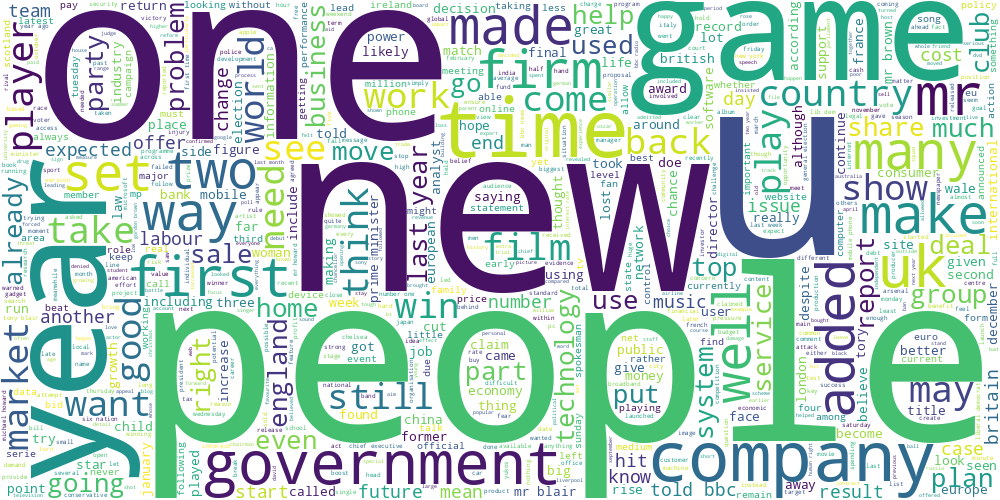

In [ ]:
draw_wordcloud(data.text)

**Задание 2.1 (1 балл).** Обучите алгоритм K-Means на tf-idf представлениях текстов. При обучении tf-idf векторайзера рекомендуется отбрасывать редко встречающиеся слова, а также воздержитесь от использования N-грамм. Возьмите не очень большое число кластеров, чтобы было удобно интерпретировать получившиеся темы (например, `n_clusters` = 8). Постройте облака тегов для текстов из разных кластеров.

In [ ]:
from nltk.tokenize import word_tokenize
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from string import punctuation

In [ ]:
def custom_tokenizer(text): #Взял функцию из моей домашки по иаду (омо)

  text_1 = text.lower()
  list_tokens = word_tokenize(text_1)
  tokens = list_tokens.copy()
  for word in list_tokens:
     if word in list(stop_words) or word in list(punctuation) or (len(word) == 1 and ord(word) >= 128):
      tokens.remove(word)

  return tokens

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

tfidf_vec = TfidfVectorizer(tokenizer = custom_tokenizer, min_df=3) #Выбросил редкие слова

vectorized_tfidf = tfidf_vec.fit_transform(data['text'])

In [ ]:
labels = KMeans(n_clusters=5, random_state=20).fit_predict(vectorized_tfidf)

In [ ]:
data['labels_kmeans'] = labels

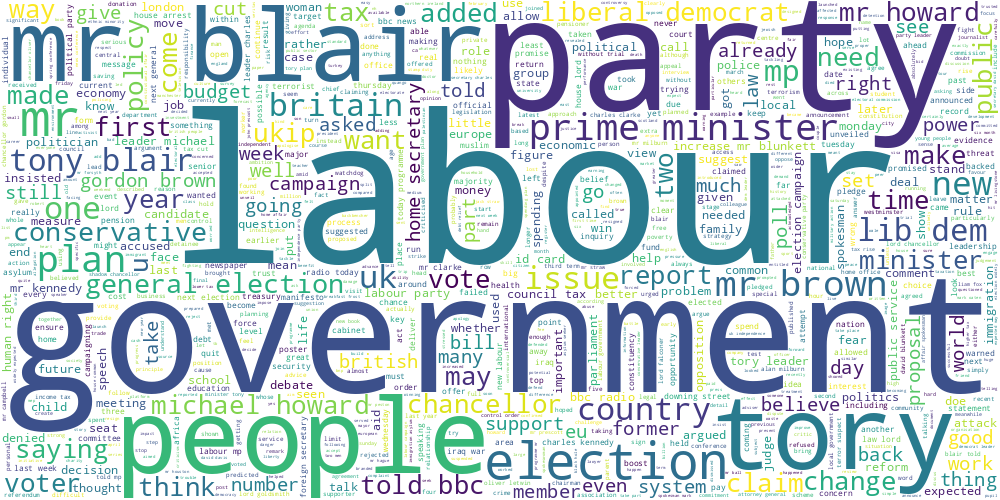

In [ ]:
data_kmeans_0 = data[data['labels_kmeans'] == 0]['text']
draw_wordcloud(data_kmeans_0)

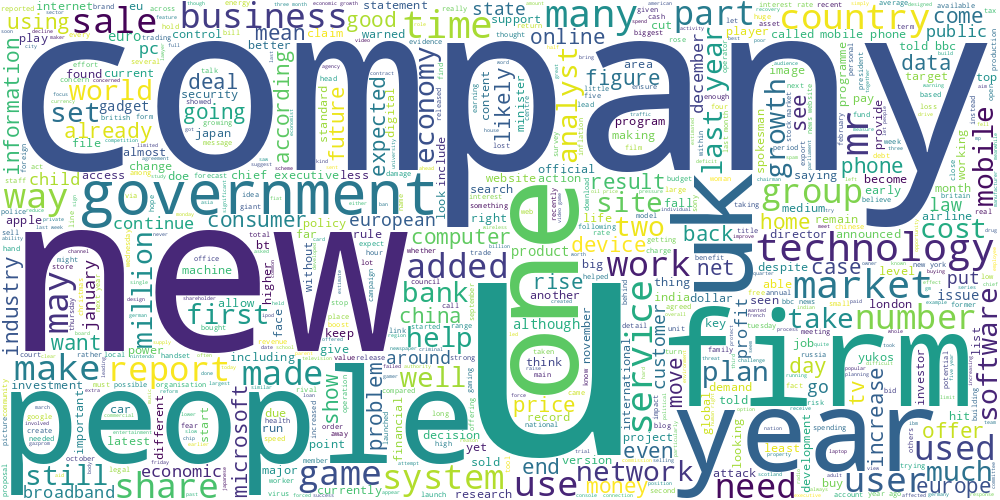

In [ ]:
data_kmeans_1 = data[data['labels_kmeans'] == 1]['text']
draw_wordcloud(data_kmeans_1)

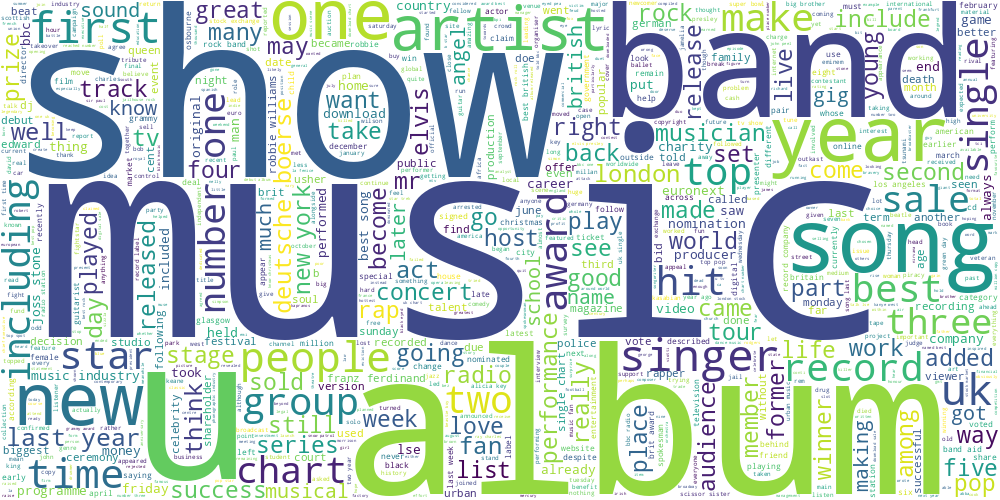

In [ ]:
data_kmeans_2 = data[data['labels_kmeans'] == 2]['text']
draw_wordcloud(data_kmeans_2)

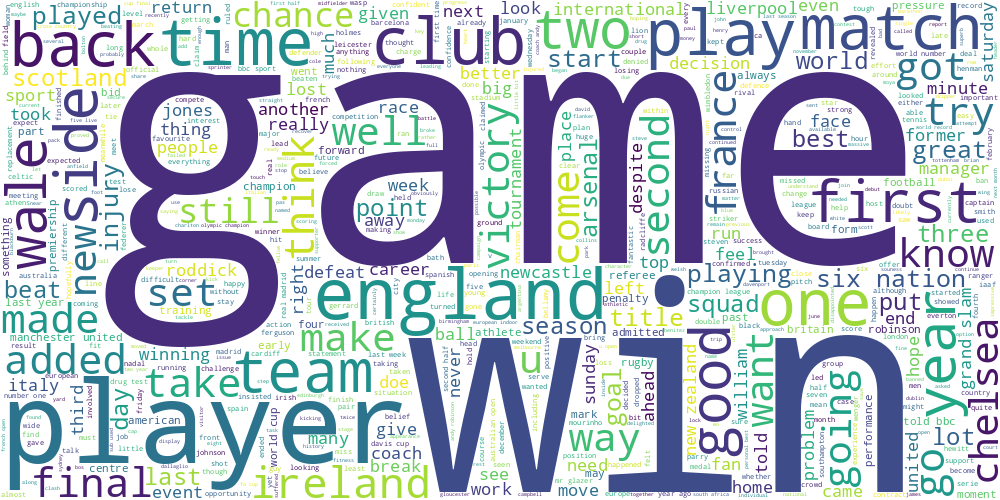

In [ ]:
data_kmeans_3 = data[data['labels_kmeans'] == 3]['text']
draw_wordcloud(data_kmeans_3)

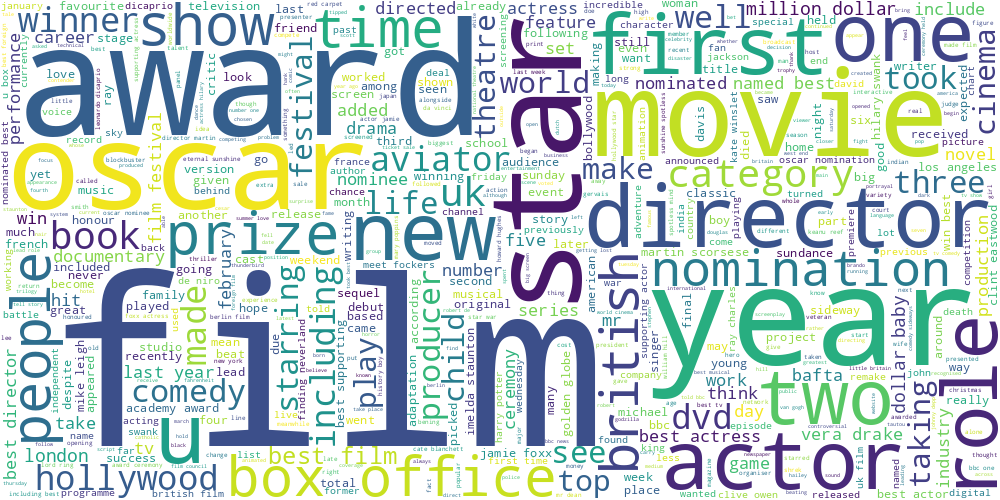

In [ ]:
data_kmeans_4 = data[data['labels_kmeans'] == 4]['text']
draw_wordcloud(data_kmeans_4)

Получились ли темы интерпретируемыми? Попробуйте озаглавить каждую тему.

**Ответ:** Я ожидал, что будет ужасная кластеризация, но на самом деле 5 кластеров оказалось очень хорошим разбиением. В *нулевой кластер* попали новости связанные с политикой, в *первый кластер* кластер попали финансы и экономика, во *второй кластер* попали новости связанные с музыкой, в *третий кластер* попали новости, связанные со спортом и в *четвертый кластер* попали новости связанные с фильмами и шоубизнесом.

**Задание 2.2 (0.5 балла).** Попробуем другой способ выделить ключевые слова для каждой темы. Помимо непосредственного разбиения объектов алгоритм K-Means получает центр каждого кластера. Попробуйте взять центры кластеров и посмотреть на слова, для которых значения соответствующих им признаков максимальны.

In [ ]:
kmeans = KMeans(n_clusters=5, random_state=20).fit(vectorized_tfidf)
center_of_clusters = kmeans.cluster_centers_

In [ ]:
top_n = 25
terms = tfidf_vec.get_feature_names_out()

cluters_center = {}

for i, center in enumerate(center_of_clusters):
    top_indices = center.argsort()[-top_n:][::-1]  # индексы top_n слов по убыванию
    list_of_words = [terms[idx] for idx in top_indices]
    cluters_center[i] = list_of_words

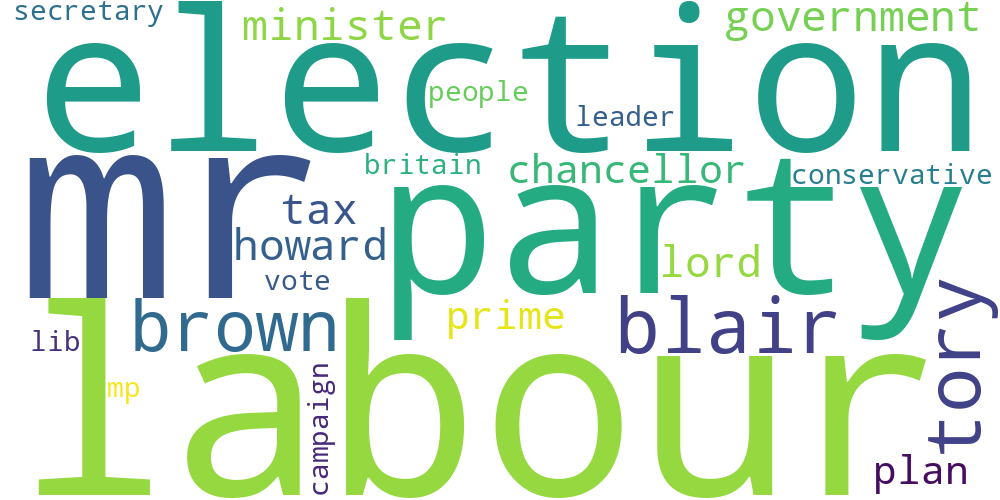

In [ ]:
draw_wordcloud(cluters_center[0])

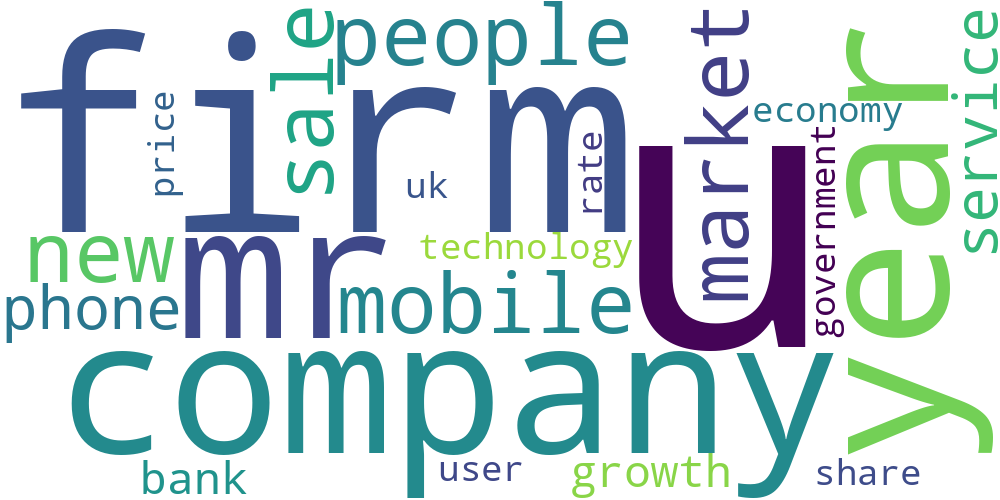

In [ ]:
draw_wordcloud(cluters_center[1])

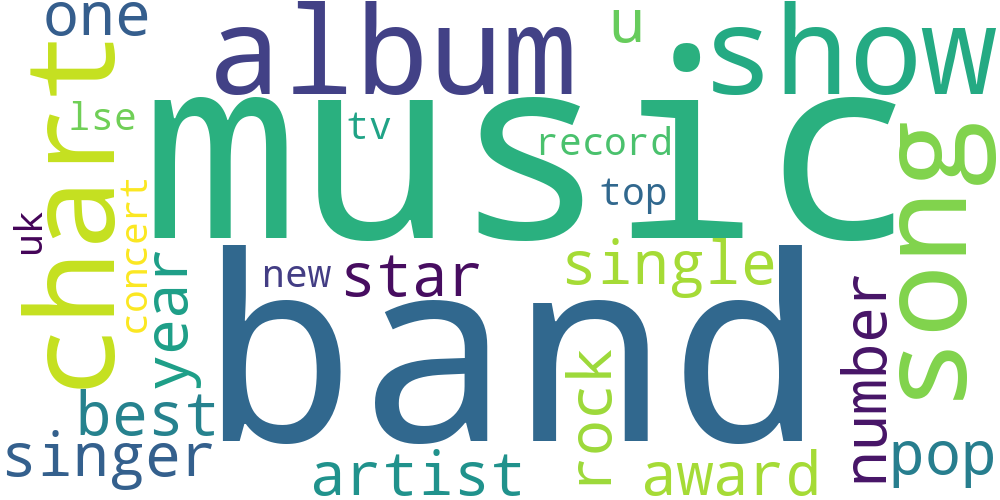

In [ ]:
draw_wordcloud(cluters_center[2])

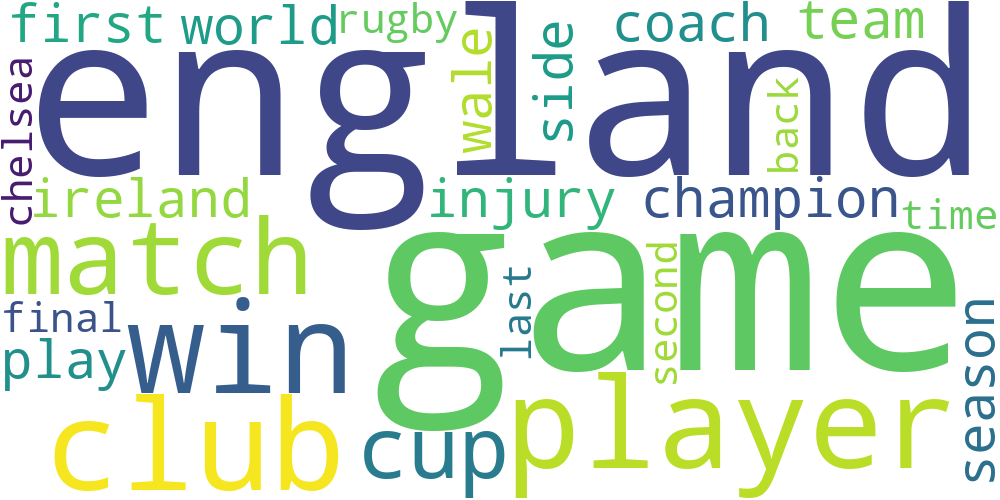

In [ ]:
draw_wordcloud(cluters_center[3])

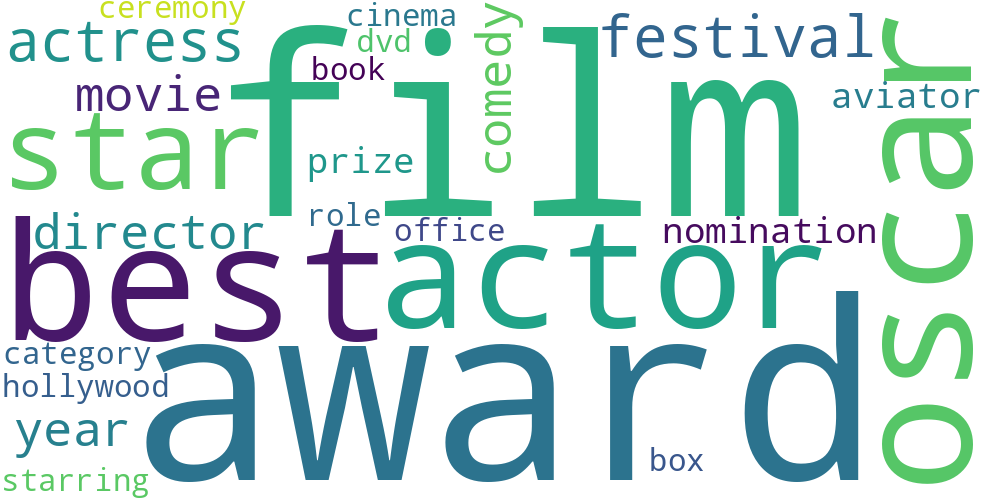

In [ ]:
draw_wordcloud(cluters_center[4])

Согласуются ли полученные слова с облаками тегов из прошлого задания?

**Ответ:** Да, согласуются с облаками тегов из 2.1

**Задание 2.3 (1.5 балла).** В первой части мы сравнили три разных алгоритма кластеризации на географических данных. Проделаем то же самое для текстовых данных (в качестве признакого описания снова используем tf-idf). Получите три разбиения на кластеры с помощью алгоритмов K-Means, DBSCAN и спектральной кластеризации (на этот раз воспользуйтесь реализацией из `sklearn`). Для K-Means и спектральной кластеризации возьмите одинаковое небольшое число кластеров, подберите параметр `eps` метода DBSCAN так, чтобы получить приблизительно такое же число кластеров (подумайте, как это можно сделать)

Далее, обучите двухмерные t-SNE представления над tf-idf признаками текстов. Визуализируйте эти представления для каждого алгоритма, раскрасив каждый кластер своим цветом. Лучше всего расположить визуализации на одном графике на трех разных сабплотах. Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

Начнем с Kmeans

In [ ]:
def objective(trial):
      param = {
      'n_clusters' : trial.suggest_categorical('n_clusters', list(range(2, 13)))
      }

      model = KMeans(**param,random_state=20)
      pred = model.fit_predict(vectorized_tfidf)
      sil_score = silhouette_score(vectorized_tfidf, pred)

      return sil_score

study = optuna.create_study(directions=["maximize"])
study.optimize(objective, n_trials=100)

trials = study.best_trials

best_trials = study.best_trials

for i in range(len(best_trials)):
  print(f'{best_trials[i].params} silhouette_score {best_trials[i].values}')

[I 2025-04-12 09:03:09,796] A new study created in memory with name: no-name-612245d0-aaca-4d17-8067-571739e9fbee
[I 2025-04-12 09:03:11,132] Trial 0 finished with value: 0.013551925174585857 and parameters: {'n_clusters': 5}. Best is trial 0 with value: 0.013551925174585857.
[I 2025-04-12 09:03:13,451] Trial 1 finished with value: 0.014681212314445625 and parameters: {'n_clusters': 8}. Best is trial 1 with value: 0.014681212314445625.
[I 2025-04-12 09:03:15,216] Trial 2 finished with value: 0.013551925174585857 and parameters: {'n_clusters': 5}. Best is trial 1 with value: 0.014681212314445625.
[I 2025-04-12 09:03:16,691] Trial 3 finished with value: 0.016137494561786304 and parameters: {'n_clusters': 10}. Best is trial 3 with value: 0.016137494561786304.
[I 2025-04-12 09:03:17,642] Trial 4 finished with value: 0.013551925174585857 and parameters: {'n_clusters': 5}. Best is trial 3 with value: 0.016137494561786304.
[I 2025-04-12 09:03:19,041] Trial 5 finished with value: 0.01337587760

Number of finished trials: 100
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhouette_score [0.017306645051983573]
{'n_clusters': 11} silhou

Получаем, что оптимальное число кластеров равен 11.

In [ ]:
kmeans_new = KMeans(n_clusters = 11, random_state=20).fit_predict(vectorized_tfidf)

In [ ]:
dict((i, kmeans_new.tolist().count(i)) for i in kmeans_new.tolist())

{8: 397,
 6: 148,
 7: 366,
 0: 148,
 1: 195,
 10: 135,
 5: 160,
 2: 185,
 3: 186,
 9: 180,
 4: 125}

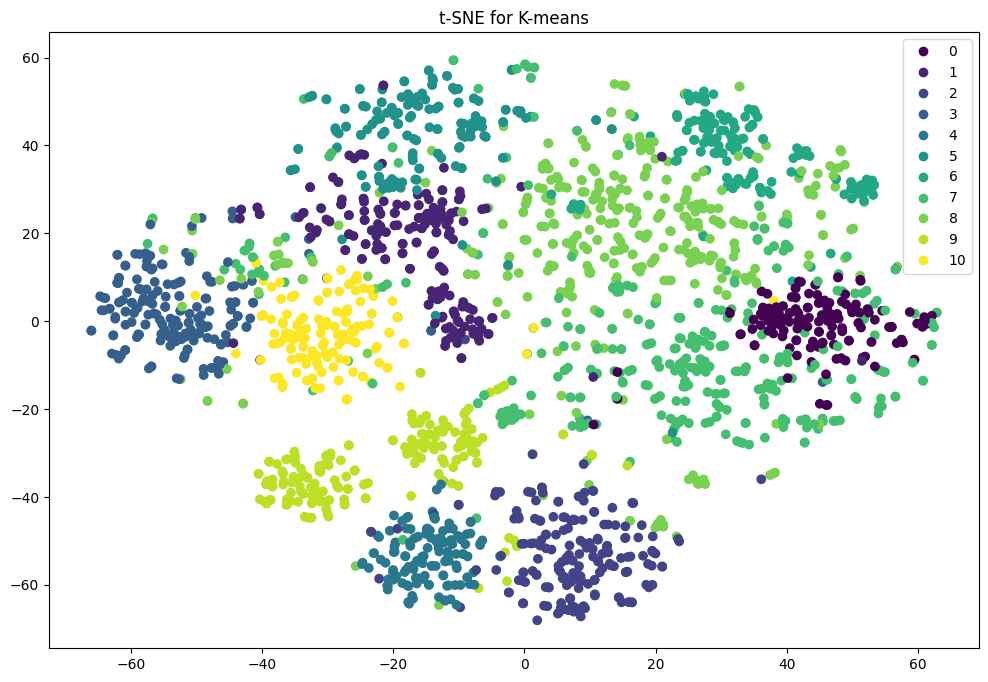

In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=152)
tsne_results = tsne.fit_transform(vectorized_tfidf.toarray())

tsne_df = pd.DataFrame(tsne_results, columns=['TSNE1', 'TSNE2'])
tsne_df['Cluster_kmeans'] = kmeans_new

plt.figure(figsize=(12, 8))
scatter = plt.scatter(tsne_df['TSNE1'], tsne_df['TSNE2'], c=tsne_df['Cluster_kmeans'], cmap='viridis')
plt.legend(*scatter.legend_elements())
plt.title('t-SNE for K-means')
plt.show()

Теперь попробуем для спектральной кластеризации

In [ ]:
def objective(trial):
      param = {
      'n_clusters' : trial.suggest_categorical('n_clusters', list(range(2, 11)))
      }

      model = SpectralClustering(**param,random_state=20)
      pred = model.fit_predict(vectorized_tfidf)
      sil_score = silhouette_score(vectorized_tfidf, pred)

      return sil_score

study = optuna.create_study(directions=["maximize"])
study.optimize(objective, n_trials=60)

trials = study.best_trials

best_trials = study.best_trials

for i in range(len(best_trials)):
  print(f'{best_trials[i].params} silhouette_score {best_trials[i].values}')

[I 2025-04-12 09:11:05,496] A new study created in memory with name: no-name-896a4347-7f50-47cd-86f0-7b0990da0d37
[I 2025-04-12 09:11:08,391] Trial 0 finished with value: 0.011608180554713765 and parameters: {'n_clusters': 4}. Best is trial 0 with value: 0.011608180554713765.
[I 2025-04-12 09:11:10,249] Trial 1 finished with value: 0.011608180554713765 and parameters: {'n_clusters': 4}. Best is trial 0 with value: 0.011608180554713765.
[I 2025-04-12 09:11:12,044] Trial 2 finished with value: 0.005279927154184689 and parameters: {'n_clusters': 2}. Best is trial 0 with value: 0.011608180554713765.
[I 2025-04-12 09:11:13,873] Trial 3 finished with value: 0.009264312894632825 and parameters: {'n_clusters': 3}. Best is trial 0 with value: 0.011608180554713765.
[I 2025-04-12 09:11:15,676] Trial 4 finished with value: 0.009264312894632825 and parameters: {'n_clusters': 3}. Best is trial 0 with value: 0.011608180554713765.
[I 2025-04-12 09:11:17,662] Trial 5 finished with value: 0.014444375004

Number of finished trials: 60
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.014680310768789485]
{'n_clusters': 9} silhouette_score [0.0146

In [ ]:
spect_clust = SpectralClustering(n_clusters=9, random_state=20).fit_predict(vectorized_tfidf)

In [ ]:
dict((i, spect_clust.tolist().count(i)) for i in spect_clust.tolist())

{2: 1002, 0: 149, 4: 22, 8: 164, 6: 93, 1: 464, 7: 161, 3: 14, 5: 156}

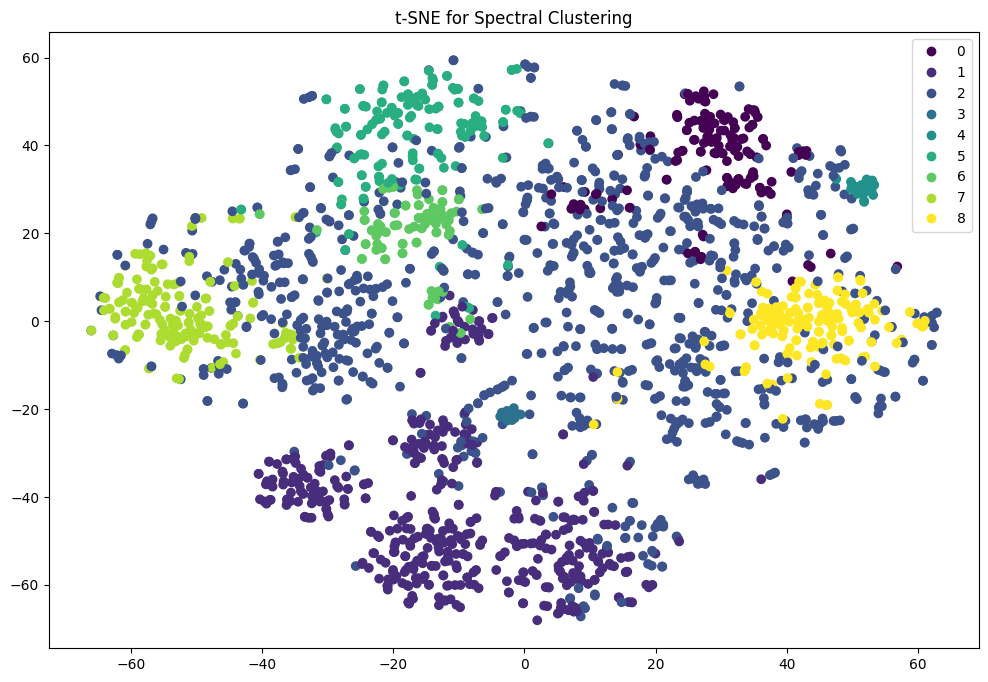

In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=152)
tsne_results = tsne.fit_transform(vectorized_tfidf.toarray())

tsne_df = pd.DataFrame(tsne_results, columns=['TSNE1', 'TSNE2'])
tsne_df['Cluster_spect'] = spect_clust

plt.figure(figsize=(12, 8))
scatter = plt.scatter(tsne_df['TSNE1'], tsne_df['TSNE2'], c=tsne_df['Cluster_spect'], cmap='viridis')
plt.legend(*scatter.legend_elements())
plt.title('t-SNE for Spectral Clustering')
plt.show()

На конец, перейдем к DBSCAN

In [ ]:
def objective(trial):
      param = {
      'eps' : trial.suggest_float('eps', 0.0001, 5.1),
      'min_samples': trial.suggest_categorical('min_samples', range(3, 61))
      }

      model = DBSCAN(**param)
      pred = model.fit_predict(vectorized_tfidf)

      if len(np.unique(pred)) < 2:
        return -1.0

      ch_score = calinski_harabasz_score(vectorized_tfidf.toarray(), pred)

      return ch_score

study = optuna.create_study(directions=["maximize"])
study.optimize(objective, n_trials=100)

trials = study.best_trials



best_trials = study.best_trials

for i in range(len(best_trials)):
  print(f'{best_trials[i].params} ch_score {best_trials[i].values}')

[I 2025-04-12 09:18:17,918] A new study created in memory with name: no-name-ce672c2c-3282-44ae-a259-70ba293e6851
[I 2025-04-12 09:18:18,799] Trial 0 finished with value: -1.0 and parameters: {'eps': 4.8685953277709455, 'min_samples': 20}. Best is trial 0 with value: -1.0.
[I 2025-04-12 09:18:19,730] Trial 1 finished with value: -1.0 and parameters: {'eps': 3.3285297415002186, 'min_samples': 55}. Best is trial 0 with value: -1.0.
[I 2025-04-12 09:18:20,701] Trial 2 finished with value: -1.0 and parameters: {'eps': 2.6180385523255594, 'min_samples': 43}. Best is trial 0 with value: -1.0.
[I 2025-04-12 09:18:21,799] Trial 3 finished with value: -1.0 and parameters: {'eps': 1.6829522747471992, 'min_samples': 5}. Best is trial 0 with value: -1.0.
[I 2025-04-12 09:18:23,017] Trial 4 finished with value: -1.0 and parameters: {'eps': 4.153860910314867, 'min_samples': 24}. Best is trial 0 with value: -1.0.
[I 2025-04-12 09:18:24,974] Trial 5 finished with value: 4.879677283528064 and parameter

Number of finished trials: 100
{'eps': 1.2634256031632265, 'min_samples': 30} ch_score [11.148202602326915]


In [ ]:
dbscan_labels = DBSCAN(**{'eps': 1.1940901706451124, 'min_samples': 17}).fit_predict(vectorized_tfidf) #

In [ ]:
dict((i, dbscan_labels.tolist().count(i)) for i in dbscan_labels.tolist())

{-1: 1754,
 3: 17,
 0: 28,
 1: 40,
 7: 63,
 2: 125,
 9: 22,
 8: 39,
 4: 76,
 5: 17,
 6: 44}

Если попытаться делать такое же количетсво кластеров, сколько и для kmeans и спектральной, то получается ужасный дизбаланс, поэтому я буду делать другими гиперпараметрами.

In [ ]:
dbscan_labels = DBSCAN(**{'eps': 1.2634256031632265, 'min_samples': 30}).fit_predict(vectorized_tfidf) #

In [ ]:
dict((i, dbscan_labels.tolist().count(i)) for i in dbscan_labels.tolist())

{-1: 1117, 0: 468, 1: 416, 3: 112, 2: 59, 4: 53}

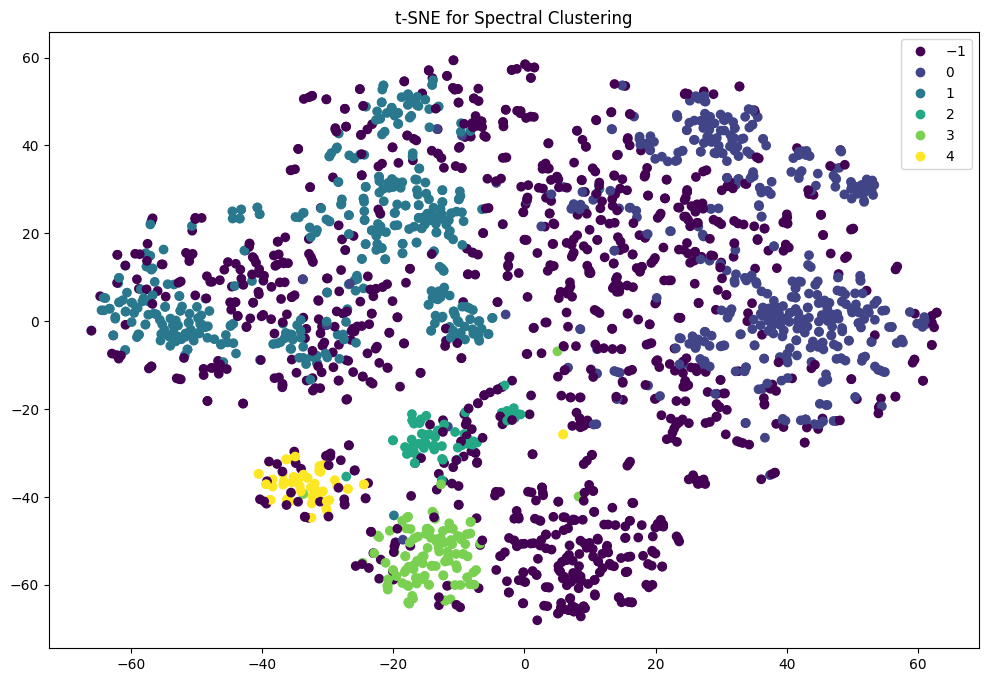

In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=152)
tsne_results = tsne.fit_transform(vectorized_tfidf.toarray())

tsne_df = pd.DataFrame(tsne_results, columns=['TSNE1', 'TSNE2'])
tsne_df['Cluster_DBSCAN'] = dbscan_labels

plt.figure(figsize=(12, 8))
scatter = plt.scatter(tsne_df['TSNE1'], tsne_df['TSNE2'], c=tsne_df['Cluster_DBSCAN'], cmap='viridis')
plt.legend(*scatter.legend_elements())
plt.title('t-SNE for Spectral Clustering')
plt.show()

Прокомментируйте получившиеся результаты. Какой баланс кластеров получился у разных методов? Соотносятся ли визуализации для текстов с визуализациями для географических данных?

**Ответ:** Ну можем начать анализировать: \



*   Kmeans показал достаточно хороший результат, дизбаланса кластеров нет (такого сильно выраженного). Можно было бы на побольше кластер поделить (например на 14 или 15), но в условии не говориться выбрать самый оптимальный, а просто оптимальный поэтому менять не буду.
*   У спектральной кластеризации присутствует сильный дизбаланс, визуально достаточно плохо делиться.
*   У DBSCAN-а тоже сильный дизбаланс присутствует, но разделение на кластеры (визуально) намного лучше чем у спектральной, но значильно хуже чем у Kmeans





**Задание 2.4 (1.5 балла).** Обучите модель латентного размещения Дирихле. Не забудьте, что она работает с мешком слов, а не с tf-idf признаками. Придумайте, как превратить распределение тем для текста в номер его кластера. Возьмите параметр `n_components` в 2-3 раза больше, чем число кластеров для K-Means.

In [ ]:
from sklearn.decomposition import LatentDirichletAllocation

In [ ]:
cv = CountVectorizer(tokenizer = custom_tokenizer, min_df=3)

vectorized_cv = cv.fit_transform(data['text'])

In [ ]:
opt_clust = 11*2
terms_cv = cv.get_feature_names_out()

ld = LatentDirichletAllocation(n_components = opt_clust, random_state = 52)
ld.fit_transform(vectorized_cv)

array([[2.16450217e-04, 2.16450217e-04, 1.75306491e-01, ...,
        2.16450217e-04, 2.16450217e-04, 1.92478104e-01],
       [2.11416491e-04, 2.11416491e-04, 2.51387050e-01, ...,
        6.60726149e-02, 2.11416491e-04, 7.91139723e-03],
       [3.09214596e-04, 3.09214596e-04, 8.58571696e-01, ...,
        3.09214596e-04, 3.09214595e-04, 3.09214596e-04],
       ...,
       [8.86053520e-05, 7.51116219e-01, 8.86053522e-05, ...,
        8.86053522e-05, 8.86053521e-05, 1.04544105e-01],
       [2.29568412e-04, 5.06726795e-01, 2.29568412e-04, ...,
        2.29568412e-04, 2.29568412e-04, 2.95218547e-01],
       [3.40994340e-05, 6.52117932e-01, 3.40994340e-05, ...,
        3.40994341e-05, 3.40994340e-05, 3.40994340e-05]])

In [ ]:
def visualize_lda_topics(lda_model, feature_names, n_top_words=20):
    for topic_idx, topic in enumerate(lda_model.components_):

        topic_words = {feature_names[i]: topic[i] for i in range(len(feature_names))}

        wordcloud = WordCloud(width=800, height=400, background_color='white')
        wordcloud.generate_from_frequencies(topic_words)

        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis("off")
        plt.title(f"Topic №{topic_idx + 1}")
        plt.show()

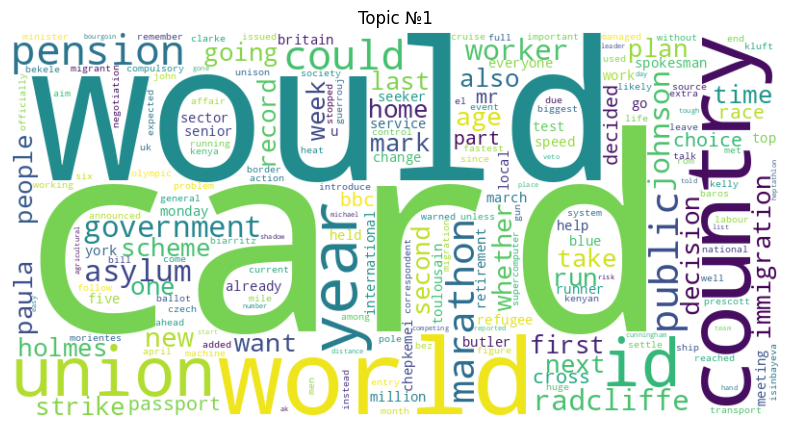

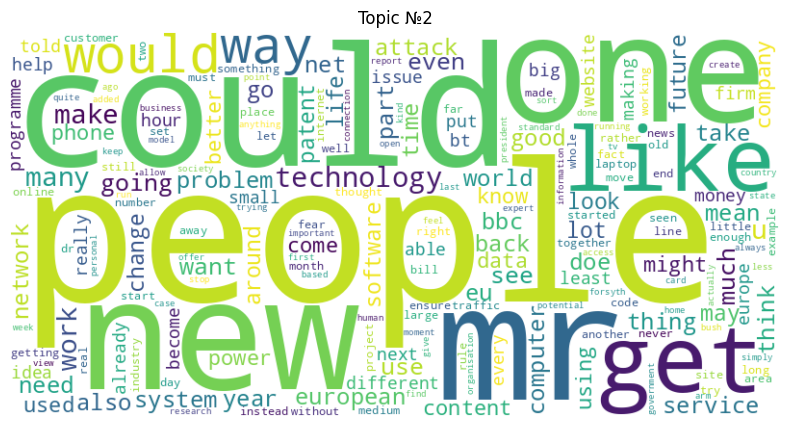

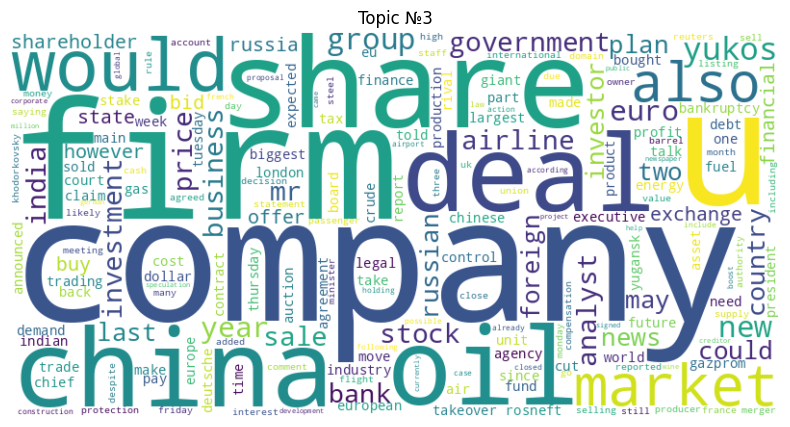

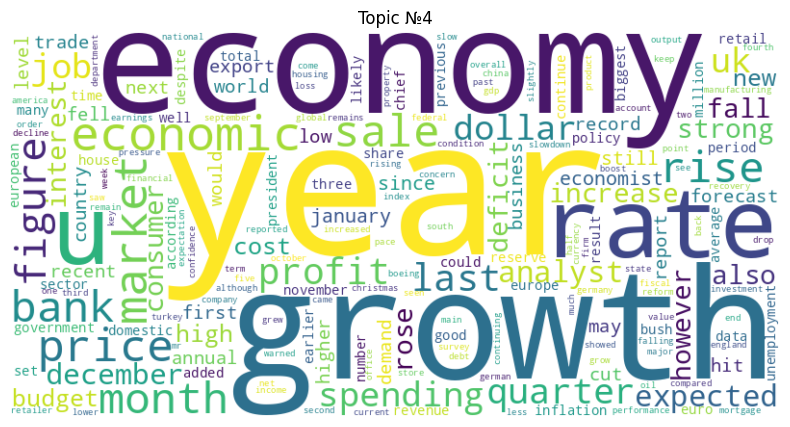

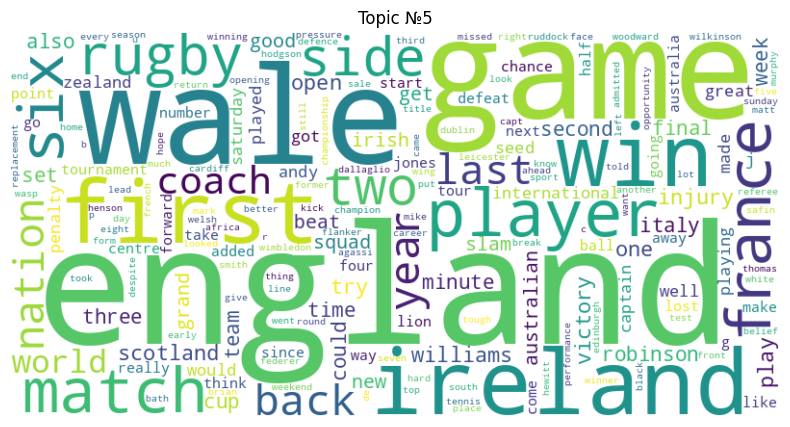

...

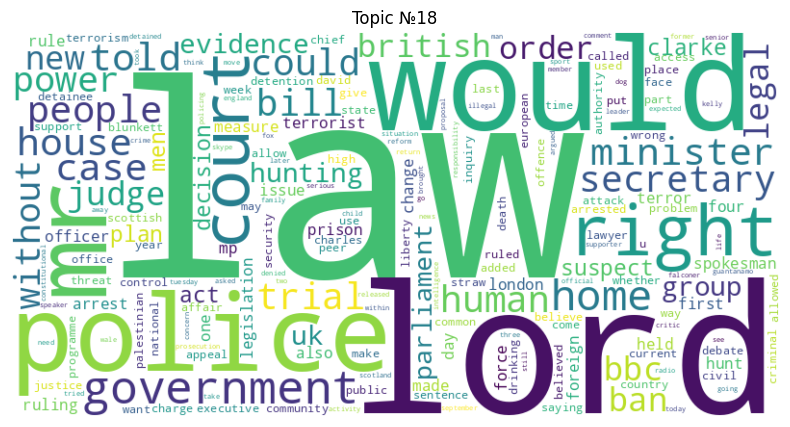

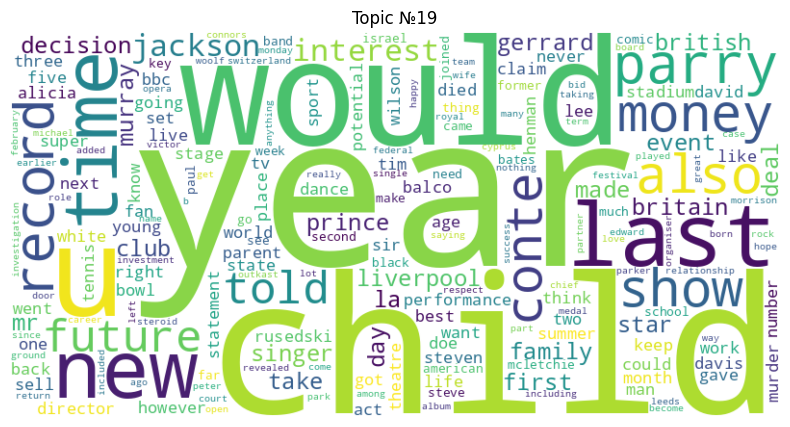

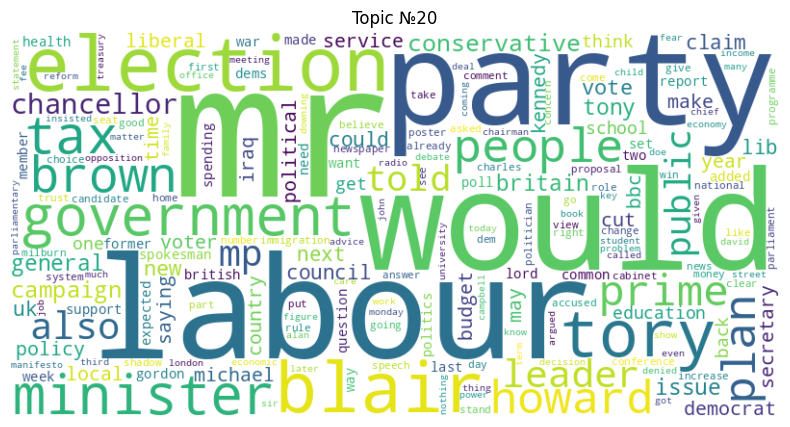

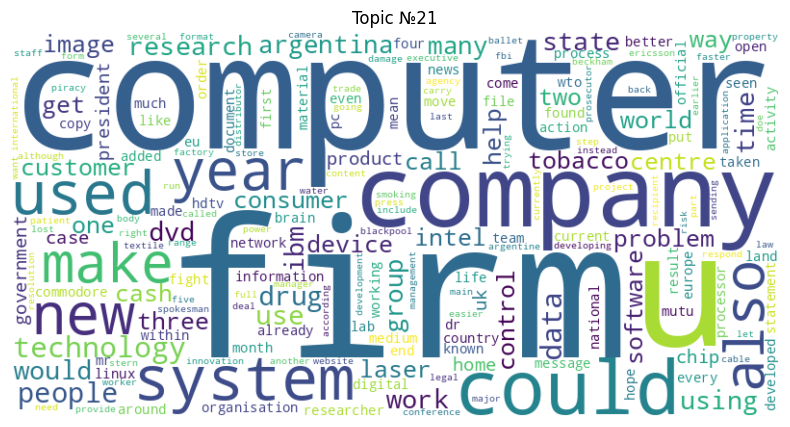

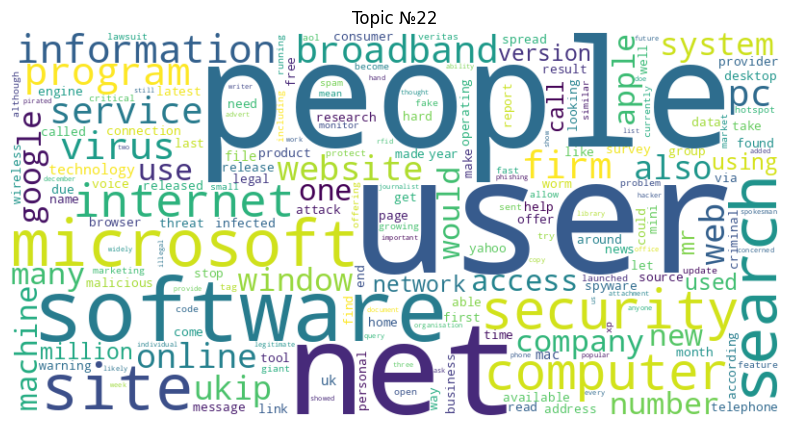

In [ ]:
visualize_lda_topics(ld, cv.get_feature_names_out())

Получились ли темы более узкими от такого нововведения? Постройте облака тегов для нескольких наиболее удачных тем.

**Ответ:** Да, темы дейтсвтельно стали намного уже. Например появился отдельный кластер для спортивных игр и для видеоигр. Но в некоторых случиях как-будто кластер делится на 2 части, хоть и должен был быть единым целым (например, 21 и 22). Но в целом не плохо, можно было бы взять просто поменьше n_components.

## Часть 3. Transfer learning и Self-Supervised Learning для задачи классификации текстов

**Задание 3.1 (0.5 балла).** Вспомним, что у нас есть разметка для тематик статей. Попробуем обучить классификатор поверх unsupervised-представлений для текстов. Рассмотрите три модели:

* Логистическая регрессия на tf-idf признаках
* K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров
* Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

Разделите выборку на обучающую и тестовую, замерьте accuracy на обоих выборках для всех трех моделей. Параметры всех моделей возьмите равными значениям по умолчанию.

Какое-то странное задание, но да ладно.

### Логистическая регрессия на tf-idf признаках

Для начало закодируем признаки.

In [ ]:
data.category.value_counts()

,count
category,
sport,511
business,510
politics,417
tech,401
entertainment,386


In [ ]:
def encoder_news(data):
  if 'sport' in data:
    return 0
  elif 'business' in data:
    return 1
  elif 'politics' in data:
    return 2
  elif 'tech' in data:
    return 3
  elif 'entertainment' in data:
    return 4

In [ ]:
data['category_enc'] = data.category.apply(encoder_news)

In [ ]:
data['category_enc'].value_counts()

,count
category_enc,
0,511
1,510
2,417
3,401
4,386


Правильно закодировали, теперь можем перейти к обучении модули

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X = data.text
y = data.category_enc
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=52, shuffle=True)

In [ ]:
tfidf_vec = TfidfVectorizer(tokenizer = custom_tokenizer, min_df=3)

X_train_tfidf = tfidf_vec.fit_transform(X_train)
X_test_tfidf = tfidf_vec.transform(X_test)

Импортируем модель и метрику

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression

In [ ]:
log_reg = LogisticRegression(multi_class='multinomial')

log_reg.fit(X_train_tfidf, y_train)
pred_train = log_reg.predict(X_train_tfidf)
pred_test = log_reg.predict(X_test_tfidf)

print(f"Accuracy on train {accuracy_score(y_train, pred_train)}")
print(f"Accuracy on test {accuracy_score(y_test, pred_test)}")

Accuracy on train 0.9967886962106616
Accuracy on test 0.9730538922155688


Предварительно скажу, что accuracy отличное.

### K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров

In [ ]:
from scipy.spatial.distance import cdist

In [ ]:
kmeans_new_new = KMeans(n_clusters = 11, random_state=20).fit(X_train_tfidf)

X_train_kmeans = cdist(X_train_tfidf.toarray(), kmeans_new_new.cluster_centers_)
X_test_kmeans = cdist(X_test_tfidf.toarray(), kmeans_new_new.cluster_centers_)

In [ ]:
log_reg_2 = LogisticRegression(multi_class='multinomial')

log_reg_2.fit(X_train_kmeans, y_train)
pred_train_2 = log_reg_2.predict(X_train_kmeans)
pred_test_2 = log_reg_2.predict(X_test_kmeans)

print(f"Accuracy on train {accuracy_score(y_train, pred_train_2)}")
print(f"Accuracy on test {accuracy_score(y_test, pred_test_2)}")

Accuracy on train 0.9087989723827874
Accuracy on test 0.8937125748502994


Тоже неплохо.

### Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

In [ ]:
cv = CountVectorizer(tokenizer = custom_tokenizer, min_df=3)

X_train_cv = cv.fit_transform(X_train)
X_test_cv = cv.transform(X_test)

In [ ]:
ld = LatentDirichletAllocation(n_components=22, random_state=52)
X_train_ld = ld.fit_transform(X_train_cv)
X_test_ld = ld.transform(X_test_cv)

In [ ]:
log_reg_3 = LogisticRegression(multi_class='multinomial')

log_reg_3.fit(X_train_ld, y_train)
pred_train_3 = log_reg_3.predict(X_train_ld)
pred_test_3 = log_reg_3.predict(X_test_ld)

print(f"Accuracy on train {accuracy_score(y_train, pred_train_3)}")
print(f"Accuracy on test {accuracy_score(y_test, pred_test_3)}")

Accuracy on train 0.9132947976878613
Accuracy on test 0.9535928143712575


Тут вообще тест больше чем трейн, это как 😭

У какой модели получилось лучшее качество? С чем это связано?

**Ответ:** У самой первой модели получилось лучшее качество, потом идет третья модели и на последнем месте вторая модель. Первое место у первой модели может быть связано с тем, что модель мы учим непосредстенно на словах, то есть признаках, а вторую на растоянии от центра кластера. Третья модель просто хуже чем первая.

**Задание 3.2 (1.5 балла).** Теперь просимулируем ситуацию слабой разметки, которая часто встречается в реальных данных. Разделим обучающую выборку в пропорции 5:65:30. Будем называть части, соответственно, размеченный трейн, неразмеченный трейн и валидация.

Все unsupervised-алгоритмы (векторайзеры и алгоритмы кластеризации) запускайте на всем трейне целиком (размеченном и неразмеченном, суммарно 70%), а итоговый классификатор обучайте только на размеченном трейне (5%). Подберите гиперпараметры моделей по качеству на валидации (30%), а затем оцените качество на тестовой выборке (которая осталась от прошлого задания). Не скромничайте при подборе числа кластеров, сейчас нас интересует не интерпретируемое разбиение выборки, а итоговое качество классификации.

In [ ]:
X_train_cluster, X_val, y_train_cluster, y_val = train_test_split(X_train, y_train, test_size = 0.3, random_state = 1, shuffle=True)
X_train_unlabeled, X_train_labeled, y_train_unlabeled, y_train_labeled = train_test_split(X_train_cluster, y_train_cluster, test_size = 5/70, random_state = 1, shuffle=True)

Первая модель

In [ ]:
tfidf_vec = TfidfVectorizer(tokenizer = custom_tokenizer, min_df=3)

X_unsuper_1 = tfidf_vec.fit_transform(X_train_cluster)

X_train_labeled_1 = tfidf_vec.transform(X_train_labeled)
X_val_tfidf = tfidf_vec.transform(X_val)
X_test_labeled_1 = tfidf_vec.transform(X_test)

In [ ]:
def objective(trial):
      param = {
      'C' : trial.suggest_float('C', 0.001, 2),
      'max_iter' : trial.suggest_categorical('max_iter', list(range(1000, 10000)))
      }

      log_reg = LogisticRegression(**param, multi_class='multinomial')

      log_reg.fit(X_unsuper_1, y_train_cluster)
      pred_val = log_reg.predict(X_val_tfidf)

      acc = accuracy_score(y_val, pred_val)

      return acc

study = optuna.create_study(directions=["maximize"])
study.optimize(objective, n_trials=50)

trials = study.best_trials

best_trials = study.best_trials

for i in range(len(best_trials)):
  print(f'{best_trials[i].params} accuracy score {best_trials[i].values}')

[I 2025-04-13 09:20:01,037] A new study created in memory with name: no-name-cbcdb40c-b05d-4b45-85e9-ac74515eb47b
[I 2025-04-13 09:20:01,817] Trial 0 finished with value: 0.9658119658119658 and parameters: {'C': 1.0527156738125651, 'max_iter': 4584}. Best is trial 0 with value: 0.9658119658119658.
[I 2025-04-13 09:20:02,638] Trial 1 finished with value: 0.9658119658119658 and parameters: {'C': 1.0843181753413655, 'max_iter': 8699}. Best is trial 0 with value: 0.9658119658119658.
[I 2025-04-13 09:20:03,596] Trial 2 finished with value: 0.9658119658119658 and parameters: {'C': 0.9920437358080129, 'max_iter': 3594}. Best is trial 0 with value: 0.9658119658119658.
[I 2025-04-13 09:20:03,960] Trial 3 finished with value: 0.8675213675213675 and parameters: {'C': 0.05141930435863324, 'max_iter': 9189}. Best is trial 0 with value: 0.9658119658119658.
[I 2025-04-13 09:20:04,825] Trial 4 finished with value: 0.9658119658119658 and parameters: {'C': 1.4703779378665438, 'max_iter': 8200}. Best is 

{'C': 1.0527156738125651, 'max_iter': 4584} accuracy score [0.9658119658119658]
{'C': 1.0843181753413655, 'max_iter': 8699} accuracy score [0.9658119658119658]
{'C': 0.9920437358080129, 'max_iter': 3594} accuracy score [0.9658119658119658]
{'C': 1.4703779378665438, 'max_iter': 8200} accuracy score [0.9658119658119658]
{'C': 1.0520933673081314, 'max_iter': 8541} accuracy score [0.9658119658119658]
{'C': 0.9562640573786654, 'max_iter': 9827} accuracy score [0.9658119658119658]
{'C': 1.7082251948628648, 'max_iter': 9932} accuracy score [0.9658119658119658]
{'C': 1.352503961715791, 'max_iter': 7109} accuracy score [0.9658119658119658]
{'C': 1.913486868850148, 'max_iter': 6567} accuracy score [0.9658119658119658]
{'C': 1.3191668443703821, 'max_iter': 4764} accuracy score [0.9658119658119658]
{'C': 1.2007124522201238, 'max_iter': 2876} accuracy score [0.9658119658119658]
{'C': 1.5771708573130454, 'max_iter': 1174} accuracy score [0.9658119658119658]
{'C': 1.1164924140959143, 'max_iter': 4667

In [ ]:
log_reg = LogisticRegression(**{'C': 1.4185321604438548, 'max_iter': 1083},multi_class='multinomial')

log_reg.fit(X_train_labeled_1, y_train_labeled)
pred_train_un_1 = log_reg.predict(X_train_labeled_1)
pred_test_un_1 = log_reg.predict(X_test_labeled_1)

print(f"Accuracy on train {accuracy_score(y_train_labeled, pred_train_un_1)}")
print(f"Accuracy on test {accuracy_score(y_test, pred_test_un_1)}")

Accuracy on train 1.0
Accuracy on test 0.8413173652694611


Даже как-то хуже стало, я не знаю в чем смысл перебрать гиперпараметры для логрега 😭 Поэтому дальше я не буду перебирать гиперпараметры для логрега, тк бессмысленно.

Вторая модель

In [ ]:
def objective(trial):
      param = {
      'n_clusters' : trial.suggest_categorical('n_clusters', list(range(2, 121)))
      }

      model = KMeans(**param,random_state=20)
      kmeans = model.fit(X_unsuper_1)
      X_train_kmeans = kmeans.transform(X_unsuper_1)
      X_val_kmeans = kmeans.transform(X_val_tfidf)


      log_reg = LogisticRegression(multi_class='multinomial')

      log_reg.fit(X_train_kmeans, y_train_cluster)
      pred_val = log_reg.predict(X_val_kmeans)

      acc = accuracy_score(y_val, pred_val)

      return acc

study = optuna.create_study(directions=["maximize"])
study.optimize(objective, n_trials=50)

trials = study.best_trials

best_trials = study.best_trials

for i in range(len(best_trials)):
  print(f'{best_trials[i].params} accuracy score {best_trials[i].values}')

[I 2025-04-13 11:10:07,770] A new study created in memory with name: no-name-90a3c0c4-17b1-4651-9c0a-fa26c8bbb34b
[I 2025-04-13 11:10:08,062] Trial 0 finished with value: 0.9444444444444444 and parameters: {'n_clusters': 35}. Best is trial 0 with value: 0.9444444444444444.
[I 2025-04-13 11:10:08,647] Trial 1 finished with value: 0.9594017094017094 and parameters: {'n_clusters': 100}. Best is trial 1 with value: 0.9594017094017094.
[I 2025-04-13 11:10:09,341] Trial 2 finished with value: 0.9658119658119658 and parameters: {'n_clusters': 116}. Best is trial 2 with value: 0.9658119658119658.
[I 2025-04-13 11:10:10,002] Trial 3 finished with value: 0.9615384615384616 and parameters: {'n_clusters': 104}. Best is trial 2 with value: 0.9658119658119658.
[I 2025-04-13 11:10:10,421] Trial 4 finished with value: 0.9594017094017094 and parameters: {'n_clusters': 62}. Best is trial 2 with value: 0.9658119658119658.
[I 2025-04-13 11:10:10,869] Trial 5 finished with value: 0.9658119658119658 and par

{'n_clusters': 114} accuracy score [0.967948717948718]
{'n_clusters': 114} accuracy score [0.967948717948718]
{'n_clusters': 114} accuracy score [0.967948717948718]
{'n_clusters': 114} accuracy score [0.967948717948718]
{'n_clusters': 114} accuracy score [0.967948717948718]
{'n_clusters': 114} accuracy score [0.967948717948718]
{'n_clusters': 114} accuracy score [0.967948717948718]
{'n_clusters': 114} accuracy score [0.967948717948718]
{'n_clusters': 114} accuracy score [0.967948717948718]
{'n_clusters': 114} accuracy score [0.967948717948718]


Получаем, что оптимальное количетсво кластеров стало 114.

In [ ]:
X_unsupervised = tfidf_vec.fit_transform(X_train_cluster)

X_train_labeled_tfidf = tfidf_vec.transform(X_train_labeled)
X_test_tfidf_new = tfidf_vec.transform(X_test)

In [ ]:
kmeans_last = KMeans(n_clusters = 114, random_state = 20).fit(X_unsupervised)

X_train_kmeans_dist_last = cdist(X_train_labeled_tfidf.toarray(), kmeans_last.cluster_centers_)
X_test_kmeans_dist_last = cdist(X_test_tfidf_new.toarray(), kmeans_last.cluster_centers_)

In [ ]:
log_reg_new_2 = LogisticRegression(multi_class='multinomial')

log_reg_new_2.fit(X_train_kmeans_dist_last, y_train_labeled)

pred_train_un_2 = log_reg_new_2.predict(X_train_kmeans_dist_last)
pred_test_un_2 = log_reg_new_2.predict(X_test_kmeans_dist_last)

print(f"Accuracy on train {accuracy_score(y_train_labeled, pred_train_un_2)}")
print(f"Accuracy on test {accuracy_score(y_test, pred_test_un_2)}")

Accuracy on train 0.9487179487179487
Accuracy on test 0.812874251497006


Тут резальтут даже можно сказать стало намного лучше, даже приблизился к первой модели из предыдущего пункта.

Теперь попробуем третью модель.

In [ ]:
cv = CountVectorizer(tokenizer = custom_tokenizer, min_df=3)

In [ ]:
X_unsuper_3 = cv.fit_transform(X_train_cluster)

X_train_labeled_3 = cv.transform(X_train_labeled)
X_val_cv = cv.transform(X_val)
X_test_labeled_3 = cv.transform(X_test)

In [ ]:
def objective(trial):
      param = {
      'n_components' : trial.suggest_categorical('n_components', list(range(2, 121)))
      }

      ld = LatentDirichletAllocation(**param, random_state=20)
      X_train_ld = ld.fit_transform(X_unsuper_3)
      X_val_ld = ld.transform(X_val_cv)

      log_reg = LogisticRegression(multi_class='multinomial')

      log_reg.fit(X_train_ld, y_train_cluster)
      pred_val = log_reg.predict(X_val_ld)

      acc = accuracy_score(y_val, pred_val)

      return acc

study = optuna.create_study(directions=["maximize"])
study.optimize(objective, n_trials=50)

trials = study.best_trials

best_trials = study.best_trials

for i in range(len(best_trials)):
  print(f'{best_trials[i].params} accuracy score {best_trials[i].values}')

[I 2025-04-13 09:29:22,064] A new study created in memory with name: no-name-b5b9aff9-262d-4eda-b0dd-750f1feb1698
[I 2025-04-13 09:29:32,123] Trial 0 finished with value: 0.9401709401709402 and parameters: {'n_components': 50}. Best is trial 0 with value: 0.9401709401709402.
[I 2025-04-13 09:29:37,543] Trial 1 finished with value: 0.5299145299145299 and parameters: {'n_components': 2}. Best is trial 0 with value: 0.9401709401709402.
[I 2025-04-13 09:29:53,976] Trial 2 finished with value: 0.9423076923076923 and parameters: {'n_components': 117}. Best is trial 2 with value: 0.9423076923076923.
[I 2025-04-13 09:30:07,646] Trial 3 finished with value: 0.9337606837606838 and parameters: {'n_components': 96}. Best is trial 2 with value: 0.9423076923076923.
[I 2025-04-13 09:30:23,225] Trial 4 finished with value: 0.9423076923076923 and parameters: {'n_components': 117}. Best is trial 2 with value: 0.9423076923076923.
[I 2025-04-13 09:30:30,824] Trial 5 finished with value: 0.9358974358974359

{'n_components': 53} accuracy score [0.9529914529914529]
{'n_components': 53} accuracy score [0.9529914529914529]
{'n_components': 53} accuracy score [0.9529914529914529]
{'n_components': 53} accuracy score [0.9529914529914529]
{'n_components': 53} accuracy score [0.9529914529914529]
{'n_components': 53} accuracy score [0.9529914529914529]


Тут вообще как будто можно любой n_components...

In [ ]:
X_cv_3 = cv.fit_transform(X_train_cluster)

X_train_labeled_cv = cv.transform(X_train_labeled)
X_test_cv_3 = cv.transform(X_test)

In [ ]:
ld_new = LatentDirichletAllocation(n_components=53, random_state=20)

In [ ]:
X_unsupervised_ld = ld_new.fit_transform(X_cv_3)

X_train_labeled_ld = ld_new.transform(X_train_labeled_cv)
X_test_ld_new = ld_new.transform(X_test_cv_3)

In [ ]:
log_reg_new_3 = LogisticRegression(multi_class='multinomial')

log_reg_new_3.fit(X_train_labeled_ld, y_train_labeled)

pred_train_un_3 = log_reg_new_3.predict(X_train_labeled_ld)
pred_test_un_3 = log_reg_new_3.predict(X_test_ld_new)

print(f"Accuracy on train {accuracy_score(y_train_labeled, pred_train_un_3)}")
print(f"Accuracy on test {accuracy_score(y_test, pred_test_un_3)}")

Accuracy on train 0.8846153846153846
Accuracy on test 0.8532934131736527


Как изменились результаты по сравнению с обучением на полной разметке? Сделайте выводы.

**Ответ:** Теперь все поменялось. LDA показывает лучший результат, не переобучается в отличии от первой модели (TFIDF + логрег). Вторая модель чуть хуже чем первая. **Но** важное замечаные, потом я экспериментрировал с random_state у train_test_spite и оказалось, что качество сильно у второй модели может меняться. То есть в зависимости от сида иногда первая модель лучше, иногда вторая, но важнее всего что третья вне конкуренции и лучше остальных.





## Бонус

**Задание 4 (0.5 балла)**. Разберитесь с semi-supervised методами, которые реализованы в `sklearn` и примените их к заданию 3.2. Получилось ли добиться лучшего качества? Сделайте выводы.

In [ ]:
from sklearn.semi_supervised import LabelPropagation, LabelSpreading

In [ ]:
def objective(trial):
      param = {
      'kernel' : trial.suggest_categorical('kernel', ['rbf']),
      'gamma' : trial.suggest_float('gamma', 1, 21)
      }

      LP = LabelPropagation(**param)

      LP.fit(X_unsuper_1, y_train_cluster)
      pred_val = LP.predict(X_val_tfidf)

      acc = accuracy_score(y_val, pred_val)

      return acc

study = optuna.create_study(directions=["maximize"])
study.optimize(objective, n_trials=50)

trials = study.best_trials

best_trials = study.best_trials

for i in range(len(best_trials)):
  print(f'{best_trials[i].params} accuracy score {best_trials[i].values}')

[I 2025-04-16 08:04:08,002] A new study created in memory with name: no-name-f10bdd82-96e4-47db-aba3-ba40b9d71c7a
[I 2025-04-16 08:04:08,427] Trial 0 finished with value: 0.9401709401709402 and parameters: {'kernel': 'rbf', 'gamma': 11.431230148000484}. Best is trial 0 with value: 0.9401709401709402.
[I 2025-04-16 08:04:08,778] Trial 1 finished with value: 0.9423076923076923 and parameters: {'kernel': 'rbf', 'gamma': 8.757919598156489}. Best is trial 1 with value: 0.9423076923076923.
[I 2025-04-16 08:04:09,197] Trial 2 finished with value: 0.9252136752136753 and parameters: {'kernel': 'rbf', 'gamma': 20.840147103323204}. Best is trial 1 with value: 0.9423076923076923.
[I 2025-04-16 08:04:09,528] Trial 3 finished with value: 0.9294871794871795 and parameters: {'kernel': 'rbf', 'gamma': 14.849757783349641}. Best is trial 1 with value: 0.9423076923076923.
[I 2025-04-16 08:04:09,765] Trial 4 finished with value: 0.9294871794871795 and parameters: {'kernel': 'rbf', 'gamma': 15.0550304324425

{'kernel': 'rbf', 'gamma': 7.372972451766344} accuracy score [0.9465811965811965]
{'kernel': 'rbf', 'gamma': 7.277903966001568} accuracy score [0.9465811965811965]
{'kernel': 'rbf', 'gamma': 7.436692830480569} accuracy score [0.9465811965811965]


In [ ]:
def objective(trial):
      param = {
      'kernel' : trial.suggest_categorical('kernel', ['knn']),
      'n_neighbors' : trial.suggest_categorical('n_neighbors', list(range(1, 11)))
      }

      LP = LabelPropagation(**param)

      LP.fit(X_unsuper_1, y_train_cluster)
      pred_val = LP.predict(X_val_tfidf)

      acc = accuracy_score(y_val, pred_val)

      return acc

study = optuna.create_study(directions=["maximize"])
study.optimize(objective, n_trials=50)

trials = study.best_trials

best_trials = study.best_trials

for i in range(len(best_trials)):
  print(f'{best_trials[i].params} accuracy score {best_trials[i].values}')

[I 2025-04-16 08:04:56,221] A new study created in memory with name: no-name-f3afdbd4-af55-4764-95e9-701ed4aa733c
[I 2025-04-16 08:04:56,536] Trial 0 finished with value: 0.9423076923076923 and parameters: {'kernel': 'knn', 'n_neighbors': 9}. Best is trial 0 with value: 0.9423076923076923.
[I 2025-04-16 08:04:56,762] Trial 1 finished with value: 0.9508547008547008 and parameters: {'kernel': 'knn', 'n_neighbors': 10}. Best is trial 1 with value: 0.9508547008547008.
[I 2025-04-16 08:04:56,978] Trial 2 finished with value: 0.9316239316239316 and parameters: {'kernel': 'knn', 'n_neighbors': 8}. Best is trial 1 with value: 0.9508547008547008.
[I 2025-04-16 08:04:57,193] Trial 3 finished with value: 0.9316239316239316 and parameters: {'kernel': 'knn', 'n_neighbors': 8}. Best is trial 1 with value: 0.9508547008547008.
[I 2025-04-16 08:04:57,447] Trial 4 finished with value: 0.9337606837606838 and parameters: {'kernel': 'knn', 'n_neighbors': 6}. Best is trial 1 with value: 0.9508547008547008.


{'kernel': 'knn', 'n_neighbors': 10} accuracy score [0.9508547008547008]
{'kernel': 'knn', 'n_neighbors': 10} accuracy score [0.9508547008547008]
{'kernel': 'knn', 'n_neighbors': 10} accuracy score [0.9508547008547008]
{'kernel': 'knn', 'n_neighbors': 10} accuracy score [0.9508547008547008]
{'kernel': 'knn', 'n_neighbors': 10} accuracy score [0.9508547008547008]
{'kernel': 'knn', 'n_neighbors': 10} accuracy score [0.9508547008547008]
{'kernel': 'knn', 'n_neighbors': 10} accuracy score [0.9508547008547008]
{'kernel': 'knn', 'n_neighbors': 10} accuracy score [0.9508547008547008]
{'kernel': 'knn', 'n_neighbors': 10} accuracy score [0.9508547008547008]
{'kernel': 'knn', 'n_neighbors': 10} accuracy score [0.9508547008547008]
{'kernel': 'knn', 'n_neighbors': 10} accuracy score [0.9508547008547008]
{'kernel': 'knn', 'n_neighbors': 10} accuracy score [0.9508547008547008]
{'kernel': 'knn', 'n_neighbors': 10} accuracy score [0.9508547008547008]
{'kernel': 'knn', 'n_neighbors': 10} accuracy score

In [ ]:
parametrs = {
    'kernel': 'rbf',
    'gamma': 7.372972451766344
}

LP = LabelPropagation(**parametrs)

LP.fit(X_train_labeled_1, y_train_labeled)
pred_train_LP = LP.predict(X_train_labeled_1)
pred_test_LP = LP.predict(X_test_labeled_1)

print(f"Accuracy on train {accuracy_score(y_train_labeled, pred_train_LP)}")
print(f"Accuracy on test {accuracy_score(y_test, pred_test_LP)}")

Accuracy on train 1.0
Accuracy on test 0.8278443113772455


In [ ]:
parametrs = {
    'kernel': 'knn',
    'n_neighbors': 10
}

LP = LabelPropagation(**parametrs)

LP.fit(X_train_labeled_1, y_train_labeled)
pred_train_LP = LP.predict(X_train_labeled_1)
pred_test_LP = LP.predict(X_test_labeled_1)

print(f"Accuracy on train {accuracy_score(y_train_labeled, pred_train_LP)}")
print(f"Accuracy on test {accuracy_score(y_test, pred_test_LP)}")

Accuracy on train 0.9615384615384616
Accuracy on test 0.8682634730538922


В случаи с LabelPropagation KNN оказался лучше всех тех методов, которые были у нас вручную. RGF оказался лучше, чем вторая модель из предыдущего задания, но все еще хуже чем остальные. Теперь попробуем LabelSpreading.

In [ ]:
def objective(trial):
      param = {
      'kernel' : trial.suggest_categorical('kernel', ['rbf']),
      'gamma' : trial.suggest_float('gamma', 1, 21),
      'alpha' : trial.suggest_float('alpha', 0, 1),
      }

      LS = LabelSpreading(**param)

      LS.fit(X_unsuper_1, y_train_cluster)
      pred_val = LS.predict(X_val_tfidf)

      acc = accuracy_score(y_val, pred_val)

      return acc

study = optuna.create_study(directions=["maximize"])
study.optimize(objective, n_trials=50)

trials = study.best_trials

best_trials = study.best_trials

for i in range(len(best_trials)):
  print(f'{best_trials[i].params} accuracy score {best_trials[i].values}')

[I 2025-04-16 08:12:52,374] A new study created in memory with name: no-name-5a731994-139a-40f4-ad4d-c4d31a4180b2
[I 2025-04-16 08:12:52,745] Trial 0 finished with value: 0.20726495726495728 and parameters: {'kernel': 'rbf', 'gamma': 1.6282843285499617, 'alpha': 0.7915497184416793}. Best is trial 0 with value: 0.20726495726495728.
[I 2025-04-16 08:12:53,368] Trial 1 finished with value: 0.9252136752136753 and parameters: {'kernel': 'rbf', 'gamma': 20.29725795765606, 'alpha': 0.6526771417472279}. Best is trial 1 with value: 0.9252136752136753.
[I 2025-04-16 08:12:54,946] Trial 2 finished with value: 0.9252136752136753 and parameters: {'kernel': 'rbf', 'gamma': 18.393188837458393, 'alpha': 0.5378900712038502}. Best is trial 1 with value: 0.9252136752136753.
[I 2025-04-16 08:12:55,377] Trial 3 finished with value: 0.9401709401709402 and parameters: {'kernel': 'rbf', 'gamma': 9.901277040124778, 'alpha': 0.24661745993325568}. Best is trial 3 with value: 0.9401709401709402.
[I 2025-04-16 08:

{'kernel': 'rbf', 'gamma': 7.17545146861406, 'alpha': 0.013598961317788413} accuracy score [0.9465811965811965]


In [ ]:
def objective(trial):
      param = {
      'kernel' : trial.suggest_categorical('kernel', ['knn']),
      'n_neighbors' : trial.suggest_categorical('n_neighbors', list(range(1, 21))),
      'alpha' : trial.suggest_float('alpha', 0, 1),
      }

      LS = LabelSpreading(**param)

      LS.fit(X_unsuper_1, y_train_cluster)
      pred_val = LS.predict(X_val_tfidf)

      acc = accuracy_score(y_val, pred_val)

      return acc

study = optuna.create_study(directions=["maximize"])
study.optimize(objective, n_trials=50)

trials = study.best_trials

best_trials = study.best_trials

for i in range(len(best_trials)):
  print(f'{best_trials[i].params} accuracy score {best_trials[i].values}')

[I 2025-04-16 08:14:16,175] A new study created in memory with name: no-name-d2c9d171-b217-4b72-87a5-ada3782772d9
[I 2025-04-16 08:14:16,439] Trial 0 finished with value: 0.9444444444444444 and parameters: {'kernel': 'knn', 'n_neighbors': 9, 'alpha': 0.5756312296021978}. Best is trial 0 with value: 0.9444444444444444.
[I 2025-04-16 08:14:16,689] Trial 1 finished with value: 0.9423076923076923 and parameters: {'kernel': 'knn', 'n_neighbors': 12, 'alpha': 0.3622549426548418}. Best is trial 0 with value: 0.9444444444444444.
[I 2025-04-16 08:14:16,931] Trial 2 finished with value: 0.9465811965811965 and parameters: {'kernel': 'knn', 'n_neighbors': 9, 'alpha': 0.2719344795087565}. Best is trial 2 with value: 0.9465811965811965.
[I 2025-04-16 08:14:17,187] Trial 3 finished with value: 0.9423076923076923 and parameters: {'kernel': 'knn', 'n_neighbors': 8, 'alpha': 0.2814849174204701}. Best is trial 2 with value: 0.9465811965811965.
[I 2025-04-16 08:14:17,418] Trial 4 finished with value: 0.90

{'kernel': 'knn', 'n_neighbors': 19, 'alpha': 0.11866510537489437} accuracy score [0.9594017094017094]
{'kernel': 'knn', 'n_neighbors': 19, 'alpha': 0.1352710558204028} accuracy score [0.9594017094017094]
{'kernel': 'knn', 'n_neighbors': 19, 'alpha': 0.11997721002382374} accuracy score [0.9594017094017094]


In [ ]:
parametrs = {'kernel': 'rbf', 'gamma': 7.17545146861406, 'alpha': 0.013598961317788413}

LS = LabelSpreading(**parametrs)

LS.fit(X_train_labeled_1, y_train_labeled)
pred_train_LS = LS.predict(X_train_labeled_1)
pred_test_LS = LS.predict(X_test_labeled_1)

print(f"Accuracy on train {accuracy_score(y_train_labeled, pred_train_LP)}")
print(f"Accuracy on test {accuracy_score(y_test, pred_test_LP)}")

Accuracy on train 0.9615384615384616
Accuracy on test 0.8682634730538922


In [ ]:
parametrs = {'kernel': 'knn', 'n_neighbors': 19, 'alpha': 0.11866510537489437}

LS = LabelSpreading(**parametrs)

LS.fit(X_train_labeled_1, y_train_labeled)
pred_train_LS = LS.predict(X_train_labeled_1)
pred_test_LS = LS.predict(X_test_labeled_1)

print(f"Accuracy on train {accuracy_score(y_train_labeled, pred_train_LP)}")
print(f"Accuracy on test {accuracy_score(y_test, pred_test_LP)}")

Accuracy on train 0.9615384615384616
Accuracy on test 0.8682634730538922


LabelSpreading и с KNN и c RBF показали результат на уровне LabelPropagetion c RBF. Это означает, что они лучше чем все три модели, которые мы создавали вручную.

**Задание 5 (1 балл)**. На занятиях мы обсуждали, что метрика [BCubed](https://www.researchgate.net/profile/Julio-Gonzalo-2/publication/225548032_Amigo_E_Gonzalo_J_Artiles_J_et_alA_comparison_of_extrinsic_clustering_evaluation_metrics_based_on_formal_constraints_Inform_Retriev_12461-486/links/0c96052138dbb99740000000/Amigo-E-Gonzalo-J-Artiles-J-et-alA-comparison-of-extrinsic-clustering-evaluation-metrics-based-on-formal-constraints-Inform-Retriev-12461-486.pdf) хорошо подходит для сравнения алгоритмов кластеризации, если нам известно настоящее разделение на кластеры (gold standard). Реализуйте подсчет метрики BCubed и сравните несколько алгоритмов кластеризации на текстовых данных из основного задания. В качестве gold standard используйте разметку category.

In [ ]:
def bcubed(data, pred):
    precision_total = 0
    recall_total = 0

    for i in range(len(data)):
        same_cluster = [j for j in range(len(data)) if pred[j] == pred[i]]
        same_class = [j for j in range(len(data)) if data[j] == data[i]]

        intersection = set(same_cluster) & set(same_class)

        precision_i = 0
        recall_i = 0

        if same_cluster:
          precision_i = len(intersection) / len(same_cluster)


        if same_class:
          recall_i = len(intersection) / len(same_class)

        precision_total += precision_i
        recall_total += recall_i

    precision = precision_total / len(data)
    recall = recall_total / len(data)

    f1 = 2 * precision * recall / (precision + recall)

    return f1

In [ ]:
print(f"Bcubed on train first model {bcubed(np.array(y_train_labeled), pred_train_un_1)}")
print(f"Bcubed on test first model {bcubed(np.array(y_test), pred_test_un_1)}")
print('\n')
print(f"Bcubed on train second model {bcubed(np.array(y_train_labeled), pred_train_un_2)}")
print(f"Bcubed on test second model {bcubed(np.array(y_test), pred_test_un_2)}")
print('\n')
print(f"Bcubed on train third model {bcubed(np.array(y_train_labeled), pred_train_un_3)}")
print(f"Bcubed on test third model {bcubed(np.array(y_test), pred_test_un_3)}")

Bcubed on train first model 1.0
Bcubed on test first model 0.7587048697651703


Bcubed on train second model 0.915472589961758
Bcubed on test second model 0.742155940071436


Bcubed on train third model 0.7986899783696081
Bcubed on test third model 0.7666280820658925


**Задание 6 (2 баллa)**. Спектральная кластеризация, по сути, является обычной кластеризацией KMeans поверх эмбеддингов объектов, которые получаются из лапласиана графа. А что, если мы попробуем построить эмбеддинги каким-нибудь другим способом? В этом задании мы предлагаем вам проявить немного фантазии. Возьмите какие-нибудь данные высокой размерности, чтобы задача обучения эмбеддингов имела смысл (например, картинки или тексты, желательно выбрать что-нибудь оригинальное). Придумайте или найдите какой-нибудь метод обучения эмбеддингов, примените его к данным и кластеризуйте полученные представления. Если чувствуете в себе достаточно силы, можете попробовать что-нибудь нейросетевое. Сравните ваш подход с базовыми алгоритмами кластеризации, которое мы рассмотрели в основном задании, не забывайте про визуализации! Ключевые слова для вдохновения: ***KernelPCA***, ***UMAP***, ***autoencoders***, ***gensim***.

Ну попробуем что-то нейросетевое, всегда хотел в bert лучше разобраться. Датасет возьму из hugging face отзывы из IMDB.

In [ ]:
!pip install datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 183.9/183.9 kB 2.9 MB/s eta 0:00:00a 0:00:01
  Attempting uninstall: fsspec
    Found existing installation: fsspec 2025.3.2
    Uninstalling fsspec-2025.3.2:
      Successfully uninstalled fsspec-2025.3.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2024.10.0 requires fsspec==2024.10.0, but you have fsspec 2024.12.0 which is incompatible.
torch 2.5.1+cu124 requires nvidia-cublas-cu12==12.4.5.8; platform_system == "Linux" and platform_machine == "x86_64", but you have nvidia-cublas-cu12 12.8.4.1 which is incompatible.
torch 2.5.1+cu124 requires nvidia-cudnn-cu12==9.1.0.70; platform_system == "Linux" and platform_machine == "x86_64", but you have nvidia-cudnn-cu12 9.3.0.75 which is incompatible.
torch 2.5.1+cu124 requires nvidia-cufft-cu12==11.2.1.3; platform_system == "Linux" and platform_machine == "x86_64",

In [ ]:
!pip install sentence_transformers

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.4 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 2.0 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 28.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 12.8 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.1 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 55.5 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.8.93
    Uninstalling nvidia-nvjitlink-cu12-12.8.93:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.8.93
  Attempting uninstall: nvidia-curand-cu12
    Found existing installation: nvidia-curand-cu12 10.3.9.90
    Uninstalling nvidia-curand-cu12-1

In [ ]:
from datasets import load_dataset
from sentence_transformers import SentenceTransformer

Я буду брать датасет с отзывами на фильмы из IMDB.

In [ ]:
dataset = load_dataset("imdb")

README.md:   0%|          | 0.00/7.81k [00:00<?, ?B/s]

train-00000-of-00001.parquet:   0%|          | 0.00/21.0M [00:00<?, ?B/s]

test-00000-of-00001.parquet:   0%|          | 0.00/20.5M [00:00<?, ?B/s]

unsupervised-00000-of-00001.parquet:   0%|          | 0.00/42.0M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/25000 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/25000 [00:00<?, ? examples/s]

Generating unsupervised split:   0%|          | 0/50000 [00:00<?, ? examples/s]

In [ ]:
dataset['unsupervised']['text'][0]

'This is just a precious little diamond. The play, the script are excellent. I cant compare this movie with anything else, maybe except the movie "Leon" wonderfully played by Jean Reno and Natalie Portman. But... What can I say about this one? This is the best movie Anne Parillaud has ever played in (See please "Frankie Starlight", she\'s speaking English there) to see what I mean. The story of young punk girl Nikita, taken into the depraved world of the secret government forces has been exceptionally over used by Americans. Never mind the "Point of no return" and especially the "La femme Nikita" TV series. They cannot compare the original believe me! Trash these videos. Buy this one, do not rent it, BUY it. BTW beware of the subtitles of the LA company which "translate" the US release. What a disgrace! If you cant understand French, get a dubbed version. But you\'ll regret later :)'

Вроде как загрузили, теперь заведем Bert и получим эмбеддинги (токенайзер не нужно, потому что как я понял, там в модели внутри он сам токенизирует)

In [ ]:
model = SentenceTransformer('all-MiniLM-L6-v2') # Модель послабее

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.5k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

In [ ]:
main_part = dataset['unsupervised']['text']
emb_of_imdb = model.encode(main_part, show_progress_bar=True)

Batches:   0%|          | 0/1563 [00:00<?, ?it/s]

In [ ]:
emb_of_imdb.shape

(50000, 384)

Теперь используем kmeans (перебирать не буду, потому что там 1 шаг оптуны около 2 минут длиться(()

In [ ]:
labels = KMeans(n_clusters=2, random_state=52).fit_predict(emb_of_imdb) #Взял 2 кластер, как будто делим на положительные и отрецательные отзывы

Теперь визуализируем через t-SNE

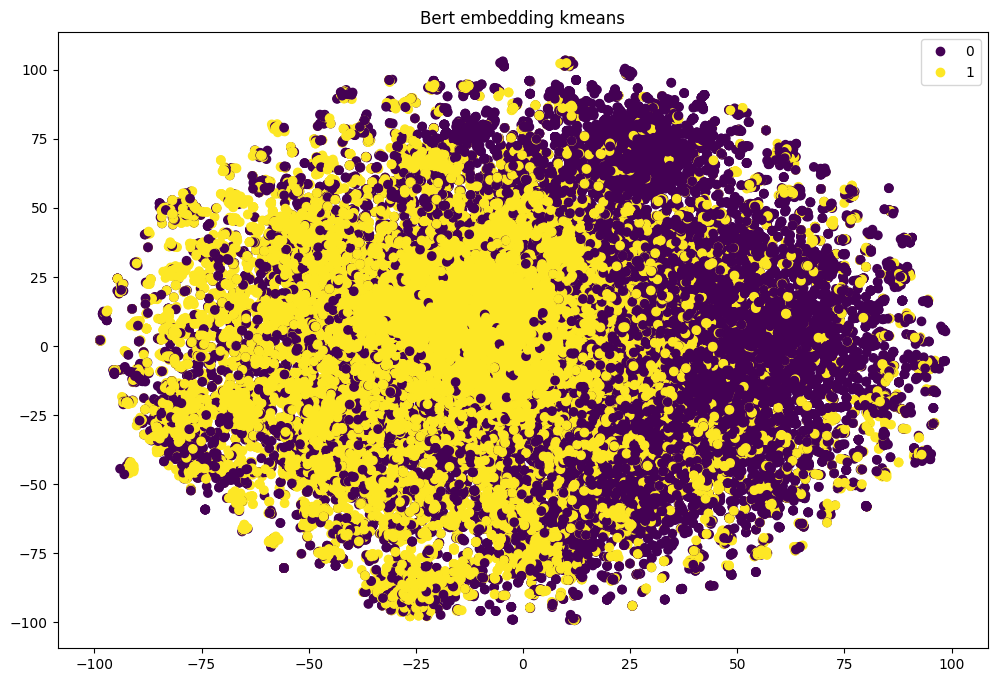

In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=152)
tsne_trans = tsne.fit_transform(emb_of_imdb)

tsne_data = pd.DataFrame(tsne_trans, columns=['TSNE1', 'TSNE2'])
tsne_data['Cluster_kmeans'] = labels

plt.figure(figsize=(12, 8))
scatter = plt.scatter(tsne_data['TSNE1'], tsne_data['TSNE2'], c=tsne_data['Cluster_kmeans'], cmap='viridis')
plt.legend(*scatter.legend_elements())
plt.title('Bert embedding kmeans')
plt.show()

Ну я ожидал, что будет получше разделение на два кластера, но в целом не так плохо, разделение какое никакое есть.